# **INTRODUCTION**

- **NAMA**   : Wawan Setiawan
- **BATCH**  : HCK-006

# **DATASET**

[Kaggle](https://kaggle.com/datasets/architsharma01/loan-approval-prediction-dataset?resource=download)



# **PROBLEM**

Develop a robust machine learning model for loan prediction that accurately classifies loan applications as either approved or rejected, while also segmenting the approved loans into three risk categories: low risk, moderate risk, and high risk. The model should leverage historical loan data, applicant information, and credit analysis to make informed decisions, enabling the lending institution to streamline the loan approval process and mitigate potential credit risks effectively.

### Business Implications:

1. **Enhanced Loan Approval Process:**
Enhancing the loan approval process involves using advanced predictive models to automate and optimize the decision-making process for loan applications. By implementing a loan prediction model, lending institutions can accurately assess the creditworthiness of applicants, predict loan approval outcomes, and expedite the approval process. This results in reduced manual reviews and faster loan decisions, improving operational efficiency and customer experience. The importance of an enhanced loan approval process lies in its ability to streamline operations, save time and resources, and increase the institution's capacity to handle a higher volume of loan applications effectively.

2. **Risk Mitigation and Improved Decision Making:**
Risk mitigation is a critical aspect of lending institutions' operations. The use of predictive models, such as credit risk assessment models, enables lenders to identify high-risk borrowers accurately. By assessing credit risk more effectively, lending institutions can make informed decisions regarding loan approvals, interest rates, and loan terms. Improved decision-making leads to a reduced risk of default and potential losses, enhancing the overall financial stability of the institution. The importance of risk mitigation lies in safeguarding the institution's financial health and ensuring responsible lending practices.

3. **Customer-Centric Approach:**
A customer-centric approach emphasizes meeting the needs and preferences of borrowers. Implementing a loan prediction model can lead to faster loan approvals and more personalized loan terms based on borrowers' credit profiles. Low-risk borrowers may receive more favorable interest rates, encouraging responsible borrowing behavior. The importance of a customer-centric approach is twofold: it enhances customer satisfaction and loyalty while also reducing the institution's exposure to high-risk borrowers, resulting in improved loan portfolio quality.

4. **Improved Portfolio Management:**
Effective portfolio management is crucial for lending institutions to maintain a balanced and diversified loan portfolio. Loan prediction models aid in categorizing loans into different risk segments (low, moderate, high), allowing institutions to optimize their portfolios by strategically allocating resources to various risk categories. A well-managed portfolio reduces the risk of concentration in high-risk loans and increases the potential for profitable returns. The importance of improved portfolio management lies in ensuring long-term financial stability and maximizing returns on investment.

5. **Compliance and Regulatory Alignment:**
Lending institutions operate within a complex regulatory landscape. Predictive models can be designed to incorporate fairness and transparency, aligning lending decisions with regulatory guidelines. This helps prevent discriminatory practices, ensures compliance with fair lending laws, and enhances the institution's reputation. The importance of compliance and regulatory alignment is to protect the institution from legal risks, maintain trust with customers and regulators, and uphold ethical lending standards.

6. Competitive Advantage:
Implementing advanced predictive models for loan approvals can provide lending institutions with a competitive advantage in the market. Faster loan processing, accurate risk assessment, and personalized loan offerings attract more borrowers and improve the institution's market positioning. A competitive advantage enables the institution to capture a larger market share, achieve higher customer retention rates, and ultimately drive business growth and profitability.attract more borrowers and enhance the institution's reputation.

# **INSTALL ENGINE**

In [180]:
# Install feature engineering
! pip install feature_engine

In [181]:
!pip install dataprep

# **IMPORT LIBRARIES**

In [182]:
# Import Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns

from feature_engine.outliers import Winsorizer
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.metrics import silhouette_samples
import matplotlib.cm as cm
from dataprep.eda import plot, plot_correlation, plot_missing, create_db_report, create_report
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, OneHotEncoder, OrdinalEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV, cross_val_score
from sklearn.metrics import classification_report
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.feature_selection import SelectKBest
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import f1_score
from sklearn.metrics import recall_score
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay
from imblearn.over_sampling import SMOTENC

import warnings
warnings.filterwarnings(action='ignore')

# **DATA LOADING**

In [183]:
# load csv
df = pd.read_csv('/content/loan_approval_dataset.csv')

In [184]:
# head
df.head(10)

,loan_id,no_of_dependents,education,self_employed,income_annum,loan_amount,loan_term,cibil_score,residential_assets_value,commercial_assets_value,luxury_assets_value,bank_asset_value,loan_status
0,1,2,Graduate,No,9600000,29900000,12,778,2400000,17600000,22700000,8000000,Approved
1,2,0,Not Graduate,Yes,4100000,12200000,8,417,2700000,2200000,8800000,3300000,Rejected
2,3,3,Graduate,No,9100000,29700000,20,506,7100000,4500000,33300000,12800000,Rejected
3,4,3,Graduate,No,8200000,30700000,8,467,18200000,3300000,23300000,7900000,Rejected
4,5,5,Not Graduate,Yes,9800000,24200000,20,382,12400000,8200000,29400000,5000000,Rejected
5,6,0,Graduate,Yes,4800000,13500000,10,319,6800000,8300000,13700000,5100000,Rejected
6,7,5,Graduate,No,8700000,33000000,4,678,22500000,14800000,29200000,4300000,Approved
7,8,2,Graduate,Yes,5700000,15000000,20,382,13200000,5700000,11800000,6000000,Rejected
8,9,0,Graduate,Yes,800000,2200000,20,782,1300000,800000,2800000,600000,Approved
9,10,5,Not Graduate,No,1100000,4300000,10,388,3200000,1400000,3300000,1600000,Rejected


In [185]:
# tail
df.tail(10)

,loan_id,no_of_dependents,education,self_employed,income_annum,loan_amount,loan_term,cibil_score,residential_assets_value,commercial_assets_value,luxury_assets_value,bank_asset_value,loan_status
4259,4260,0,Not Graduate,Yes,4500000,11500000,14,509,13400000,2300000,15400000,5900000,Rejected
4260,4261,5,Graduate,No,8800000,29300000,10,560,16800000,13900000,31100000,9900000,Approved
4261,4262,3,Graduate,Yes,3000000,7500000,6,881,1400000,4500000,6100000,2300000,Approved
4262,4263,5,Graduate,No,1300000,3000000,20,540,1000000,2300000,3200000,1900000,Rejected
4263,4264,3,Graduate,No,5000000,12700000,14,865,4700000,8100000,19500000,6300000,Approved
4264,4265,5,Graduate,Yes,1000000,2300000,12,317,2800000,500000,3300000,800000,Rejected
4265,4266,0,Not Graduate,Yes,3300000,11300000,20,559,4200000,2900000,11000000,1900000,Approved
4266,4267,2,Not Graduate,No,6500000,23900000,18,457,1200000,12400000,18100000,7300000,Rejected
4267,4268,1,Not Graduate,No,4100000,12800000,8,780,8200000,700000,14100000,5800000,Approved
4268,4269,1,Graduate,No,9200000,29700000,10,607,17800000,11800000,35700000,12000000,Approved


# **EXPLORATORY DATA ANALYSIS (EDA)**

In [186]:
# check basic information
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4269 entries, 0 to 4268
Data columns (total 13 columns):
 #   Column                     Non-Null Count  Dtype 
---  ------                     --------------  ----- 
 0   loan_id                    4269 non-null   int64 
 1    no_of_dependents          4269 non-null   int64 
 2    education                 4269 non-null   object
 3    self_employed             4269 non-null   object
 4    income_annum              4269 non-null   int64 
 5    loan_amount               4269 non-null   int64 
 6    loan_term                 4269 non-null   int64 
 7    cibil_score               4269 non-null   int64 
 8    residential_assets_value  4269 non-null   int64 
 9    commercial_assets_value   4269 non-null   int64 
 10   luxury_assets_value       4269 non-null   int64 
 11   bank_asset_value          4269 non-null   int64 
 12   loan_status               4269 non-null   object
dtypes: int64(10), object(3)
memory usage: 433.7+ KB



All values are intergers.

In [187]:
## check data duplicate
df[df.duplicated()].shape

(0, 13)

There is no duplicate rows

In [188]:
## data overview column categorical and numerical
num_col = df.describe().columns.tolist()
cat_col = df.select_dtypes(include=['object']).columns.tolist()

In [189]:
# categorical overview
for i in cat_col:
    print(i)
    print()
    print(df[i].value_counts())
    print('-' * 10)

 education

 Graduate        2144
 Not Graduate    2125
Name:  education, dtype: int64
----------
 self_employed

 Yes    2150
 No     2119
Name:  self_employed, dtype: int64
----------
 loan_status

 Approved    2656
 Rejected    1613
Name:  loan_status, dtype: int64
----------


data has low cardinality

In [190]:
df_eda = df.copy()

In [191]:
# rename categorical values for EDA purposes
df_eda[' loan_status'] = df_eda[' loan_status'].replace({' Approved': 1, ' Rejected' : 0})
df_eda[' education'] = df_eda[' education'].replace({' Graduate': 1, ' Not Graduate' : 0})
df_eda[' self_employed'] = df_eda[' self_employed'].replace({' Yes': 1, ' No' : 0})
df_eda.head()

,loan_id,no_of_dependents,education,self_employed,income_annum,loan_amount,loan_term,cibil_score,residential_assets_value,commercial_assets_value,luxury_assets_value,bank_asset_value,loan_status
0,1,2,1,0,9600000,29900000,12,778,2400000,17600000,22700000,8000000,1
1,2,0,0,1,4100000,12200000,8,417,2700000,2200000,8800000,3300000,0
2,3,3,1,0,9100000,29700000,20,506,7100000,4500000,33300000,12800000,0
3,4,3,1,0,8200000,30700000,8,467,18200000,3300000,23300000,7900000,0
4,5,5,0,1,9800000,24200000,20,382,12400000,8200000,29400000,5000000,0


DataPrep Report
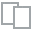
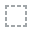
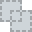
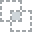
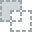
...
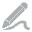
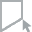
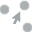
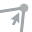
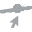

In [192]:
# describe EDA
create_report(df_eda)

## EDA ANALYSIS

1. **Dataset Statistics**
   - Number of Variables	13
   - Number of Rows	4269
   - Missing Cells	0
   - Missing Cells (%)	0.0%
   - Duplicate Rows	0
   - Duplicate Rows (%)	0.0%
	 - Numerical: 9
   - Categorical: 4
2. **Dataset Insights**
   - loan_id is uniformly distributed	Uniform
   - loan_amount and luxury_assets_value have similar distributions	Similar
     Distribution
   - income_annum is skewed	Skewed
   - no_of_dependents has constant length 1	Constant Length
   - education has constant length 1	Constant Length
   - self_employed has constant length 1	Constant Length
   - loan_status has constant length 1	Constant Length
3. **Interactions**
   - Cibil Score have have significant impact for loan status, also known as credit score, is a numerical representation of an individual's creditworthiness. It is a three-digit number ranging from 300 to 900 in India, with a higher score indicating a stronger credit profile. The credit score is generated by credit bureaus, such as the Credit Information Bureau (India) Limited (CIBIL), based on an individual's credit history and repayment behavior.
4. **Pearson Correlation**
   - Pearson correlation for this machine learning is used to create cluster for ranked the loan person
   - Based on pearson correlation `loan_amount` have high correlation with `income_annum`, `luxury_assets_value`, `bank_assets_value`, `commercial_assets_value` and `residential_assets_value`


# FEATURE ENGINEERING for UNSUPERVISED CLUSTERING SEGMENT

In [193]:
df

,loan_id,no_of_dependents,education,self_employed,income_annum,loan_amount,loan_term,cibil_score,residential_assets_value,commercial_assets_value,luxury_assets_value,bank_asset_value,loan_status
0,1,2,Graduate,No,9600000,29900000,12,778,2400000,17600000,22700000,8000000,Approved
1,2,0,Not Graduate,Yes,4100000,12200000,8,417,2700000,2200000,8800000,3300000,Rejected
2,3,3,Graduate,No,9100000,29700000,20,506,7100000,4500000,33300000,12800000,Rejected
3,4,3,Graduate,No,8200000,30700000,8,467,18200000,3300000,23300000,7900000,Rejected
4,5,5,Not Graduate,Yes,9800000,24200000,20,382,12400000,8200000,29400000,5000000,Rejected
...,...,...,...,...,...,...,...,...,...,...,...,...,...
4264,4265,5,Graduate,Yes,1000000,2300000,12,317,2800000,500000,3300000,800000,Rejected
4265,4266,0,Not Graduate,Yes,3300000,11300000,20,559,4200000,2900000,11000000,1900000,Approved
4266,4267,2,Not Graduate,No,6500000,23900000,18,457,1200000,12400000,18100000,7300000,Rejected
4267,4268,1,Not Graduate,No,4100000,12800000,8,780,8200000,700000,14100000,5800000,Approved


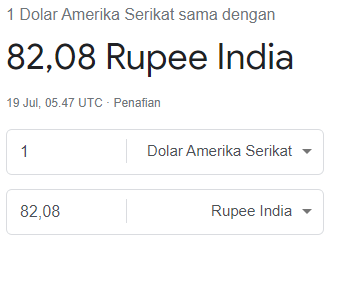

In [194]:
df_usd = df.copy()

In [195]:
# converting all rupee to USD
df_usd[' income_annum'] = df_usd[' income_annum'] / 82.08
df_usd[' loan_amount'] = df_usd[' loan_amount'] / 82.08
df_usd[' residential_assets_value'] = df_usd[' residential_assets_value'] / 82.08
df_usd[' commercial_assets_value'] = df_usd[' commercial_assets_value'] / 82.08
df_usd[' luxury_assets_value'] = df_usd[' luxury_assets_value'] / 82.08
df_usd[' bank_asset_value'] = df_usd[' bank_asset_value'] / 82.08

In [196]:
df_usd

,loan_id,no_of_dependents,education,self_employed,income_annum,loan_amount,loan_term,cibil_score,residential_assets_value,commercial_assets_value,luxury_assets_value,bank_asset_value,loan_status
0,1,2,Graduate,No,116959.064327,364278.752437,12,778,29239.766082,214424.951267,276559.454191,97465.886940,Approved
1,2,0,Not Graduate,Yes,49951.267057,148635.477583,8,417,32894.736842,26803.118908,107212.475634,40204.678363,Rejected
2,3,3,Graduate,No,110867.446394,361842.105263,20,506,86500.974659,54824.561404,405701.754386,155945.419103,Rejected
3,4,3,Graduate,No,99902.534113,374025.341131,8,467,221734.892788,40204.678363,283869.395712,96247.563353,Rejected
4,5,5,Not Graduate,Yes,119395.711501,294834.307992,20,382,151072.124756,99902.534113,358187.134503,60916.179337,Rejected
...,...,...,...,...,...,...,...,...,...,...,...,...,...
4264,4265,5,Graduate,Yes,12183.235867,28021.442495,12,317,34113.060429,6091.617934,40204.678363,9746.588694,Rejected
4265,4266,0,Not Graduate,Yes,40204.678363,137670.565302,20,559,51169.590643,35331.384016,134015.594542,23148.148148,Approved
4266,4267,2,Not Graduate,No,79191.033138,291179.337232,18,457,14619.883041,151072.124756,220516.569201,88937.621832,Rejected
4267,4268,1,Not Graduate,No,49951.267057,155945.419103,8,780,99902.534113,8528.265107,171783.625731,70662.768031,Approved


In [197]:
num_col = [' income_annum', ' loan_amount', ' loan_term', ' cibil_score', ' residential_assets_value', ' commercial_assets_value', ' luxury_assets_value', ' bank_asset_value']

In [198]:
X1 = df_usd[num_col]

## SCALING NUMERIC FOR CLUSTER

In [199]:
# scaling
scaler = StandardScaler()
X1 = pd.DataFrame(scaler.fit_transform(X1))
X1.head()

,0,1,2,3,4,5,6,7
0,1.617979,1.633052,0.192617,1.032792,-0.780058,2.877289,0.832028,0.930304
1,-0.341750,-0.324414,-0.508091,-1.061051,-0.733924,-0.631921,-0.694993,-0.515936
2,1.439822,1.610933,1.594031,-0.544840,-0.057300,-0.107818,1.996520,2.407316
3,1.119139,1.721525,-0.508091,-0.771045,1.649637,-0.381263,0.897943,0.899533
4,1.689242,1.002681,1.594031,-1.264055,0.757724,0.735304,1.568075,0.007172


## PCA

In [200]:
# PCA
pca = PCA()
pca.fit(X1)

cumsum = np.cumsum(pca.explained_variance_ratio_)
d = np.argmax(cumsum >= 0.90) + 1
d


5

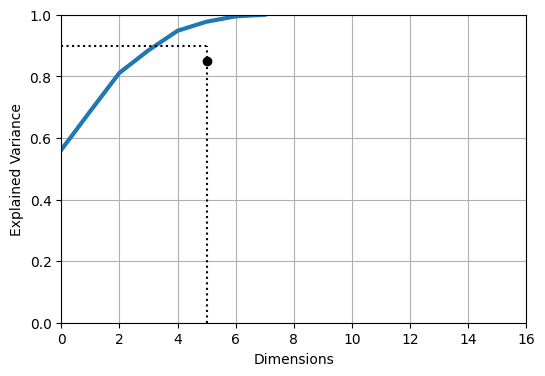

In [201]:
# plot elbow method
plt.figure(figsize=(6,4))
plt.plot(cumsum, linewidth=3)
plt.axis([0, 16, 0, 1])
plt.xlabel("Dimensions")
plt.ylabel("Explained Variance")
plt.plot([d, d], [0, 0.90], "k:")
plt.plot([0, d], [0.90, 0.90], "k:")
plt.plot(d, 0.85, "ko")
plt.annotate("Elbow", xy=(65, 0.90), xytext=(70, 0.7),
             arrowprops=dict(arrowstyle="->"), fontsize=16)
plt.grid(True)
plt.show()

based PCA targeted 90 percent of information, the result feature is 5

In [202]:
# PCA n-components =90
pca = PCA(n_components=.90)
X1 = pd.DataFrame(pca.fit_transform(X1))
X1

,0,1,2,3,4
0,2.918862,-0.877545,0.748239,2.521388,-0.388141
1,-1.271233,1.105708,-0.427411,0.128137,0.363304
2,3.209668,-0.798384,-1.503918,0.199645,1.928199
3,2.473029,0.893127,-0.218889,-1.400551,0.421732
4,2.441657,-0.259512,-1.987396,0.004024,-0.105892
...,...,...,...,...,...
4264,-2.960643,1.021279,-1.353834,-0.173664,-0.226555
4265,-1.383941,-0.967022,-1.297822,0.050950,-0.075654
4266,1.373119,-0.330436,-1.372032,1.935809,-0.052214
4267,-0.525351,-0.366029,1.055881,-0.747334,0.573807


<Axes: xlabel='0', ylabel='1'>

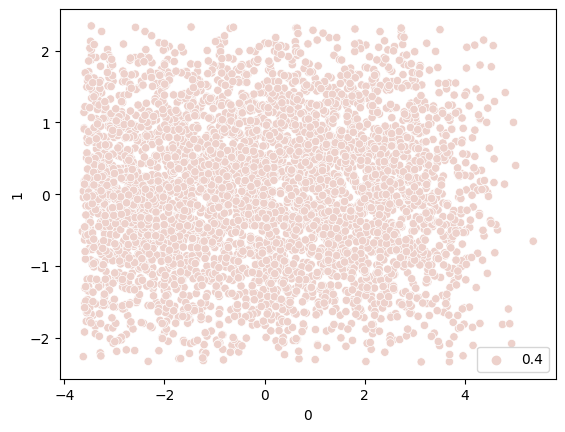

In [203]:
# for visualization, only 2 PC's saved
pca_viz = PCA(n_components=2)
X_viz = pd.DataFrame(pca_viz.fit_transform(X1))
sns.scatterplot(x=X_viz[0], y=X_viz[1],hue=0.4)

In [204]:
# make new variable contain PCA data for modeling
X_tr = X1

In [205]:
X_tr

,0,1,2,3,4
0,2.918862,-0.877545,0.748239,2.521388,-0.388141
1,-1.271233,1.105708,-0.427411,0.128137,0.363304
2,3.209668,-0.798384,-1.503918,0.199645,1.928199
3,2.473029,0.893127,-0.218889,-1.400551,0.421732
4,2.441657,-0.259512,-1.987396,0.004024,-0.105892
...,...,...,...,...,...
4264,-2.960643,1.021279,-1.353834,-0.173664,-0.226555
4265,-1.383941,-0.967022,-1.297822,0.050950,-0.075654
4266,1.373119,-0.330436,-1.372032,1.935809,-0.052214
4267,-0.525351,-0.366029,1.055881,-0.747334,0.573807


## ELBOW METHOD

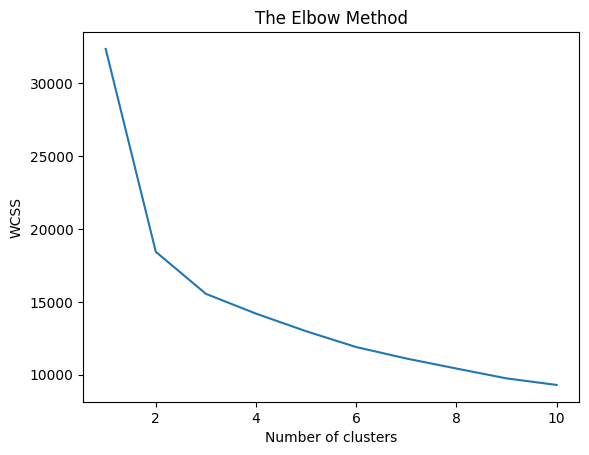

In [206]:
# Elbow method for KMeans
from sklearn.cluster import KMeans
wcss = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters = i, init = 'k-means++', random_state = 42)
    kmeans.fit(X1)
    wcss.append(kmeans.inertia_)
plt.plot(range(1, 11), wcss)
plt.title('The Elbow Method')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.show()

KMean WCSS visual describe feature importance between 2 and 4, next step will confirm using silhouette method

## SILHOUETTE METHOD

In [207]:
def plot_silhouette(model,range_n_clusters,X,model_name):
    for n_clusters in range_n_clusters:
        # Create a subplot with 1 row and 2 columns
        fig, (ax1, ax2) = plt.subplots(1, 2)
        fig.set_size_inches(18, 7)

        # The 1st subplot is the silhouette plot
        # The silhouette coefficient can range from -1, 1 but in this example all
        # lie within [-0.1, 1]
        ax1.set_xlim([-0.1, 1])
        # The (n_clusters+1)10 is for inserting blank space between silhouette
        # plots of individual clusters, to demarcate them clearly.
        ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

        clusterer = model(n_clusters=n_clusters)
        cluster_labels = clusterer.fit_predict(X)

        # The silhouette_score gives the average value for all the samples.
        # This gives a perspective into the density and separation of the formed
        # clusters
        silhouette_avg = silhouette_score(X, cluster_labels)
        print("For n_clusters =", n_clusters,
              "The average silhouette_score is :", silhouette_avg)

        # Compute the silhouette scores for each sample
        sample_silhouette_values = silhouette_samples(X, cluster_labels)

        y_lower = 10
        for i in range(n_clusters):
          # Aggregate the silhouette scores for samples belonging to
          # cluster i, and sort them
          ith_cluster_silhouette_values = \
          sample_silhouette_values[cluster_labels == i]

          ith_cluster_silhouette_values.sort()

          size_cluster_i = ith_cluster_silhouette_values.shape[0]
          y_upper = y_lower + size_cluster_i

          color = cm.nipy_spectral(float(i) / n_clusters)
          ax1.fill_betweenx(np.arange(y_lower, y_upper),
                            0, ith_cluster_silhouette_values,
                            facecolor=color, edgecolor=color, alpha=0.7)

          # Label the silhouette plots with their cluster numbers at the middle
          ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

          # Compute the new y_lower for next plot
          y_lower = y_upper + 10  # 10 for the 0 samples

          ax1.set_title("The silhouette plot for the various clusters.")
          ax1.set_xlabel("The silhouette coefficient values")
          ax1.set_ylabel("Cluster label")

          # The vertical line for average silhouette score of all the values
          ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

          ax1.set_yticks([])  # Clear the yaxis labels / ticks
          ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

          # 2nd Plot showing the actual clusters formed
          colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
          ax2.scatter(X[:, 0], X[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                            c=colors, edgecolor='k')


          ax2.set_title("The visualization of the clustered data.")
          ax2.set_xlabel("Feature space for the 1st feature")
          ax2.set_ylabel("Feature space for the 2nd feature")
          plt.suptitle((f"Silhouette analysis for {model_name} clustering on sample data "
                              "with n_clusters = %d" % n_clusters),
                            fontsize=14, fontweight='bold')

For n_clusters = 3 The average silhouette_score is : 0.23503335995466845
For n_clusters = 4 The average silhouette_score is : 0.22093808976889637
For n_clusters = 5 The average silhouette_score is : 0.1906996143447762
For n_clusters = 6 The average silhouette_score is : 0.19491413352166342
For n_clusters = 7 The average silhouette_score is : 0.19499265325893775
For n_clusters = 8 The average silhouette_score is : 0.19669929169203929


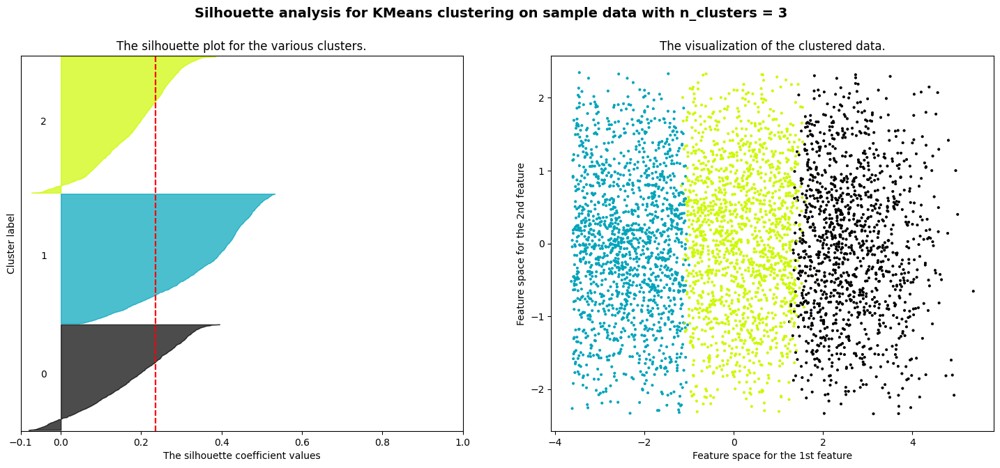

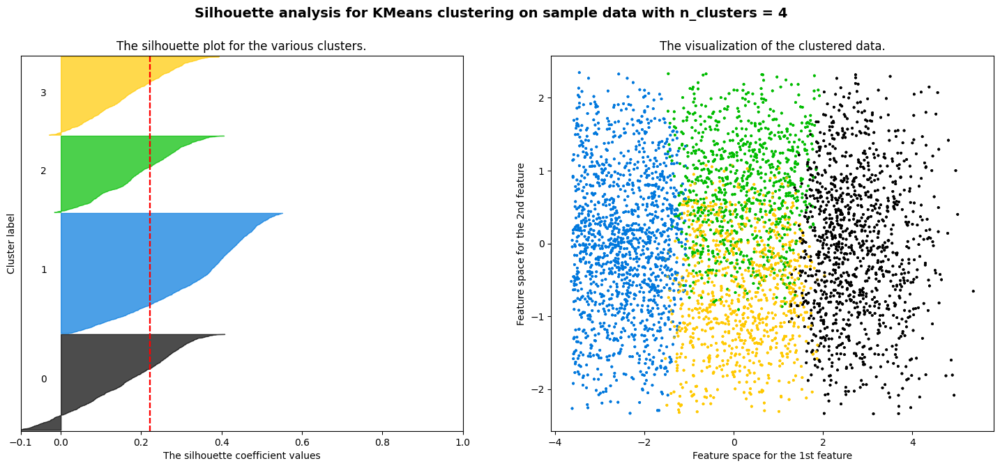

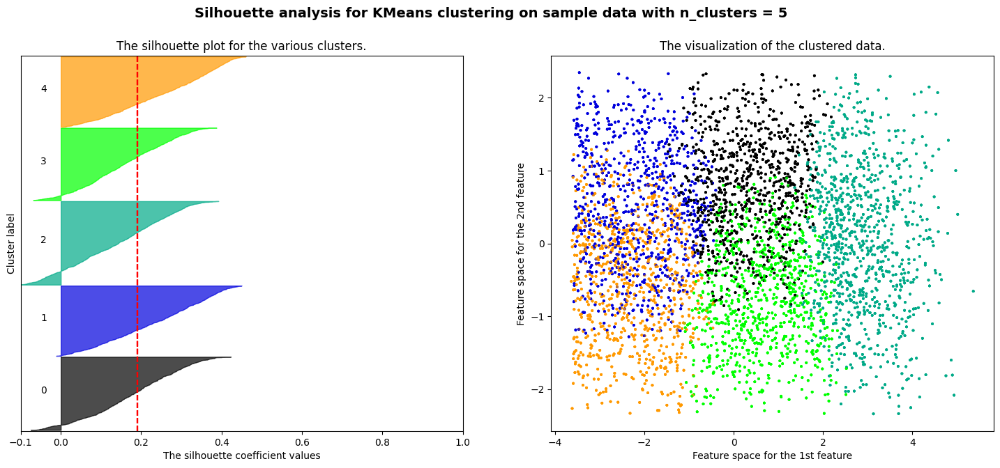

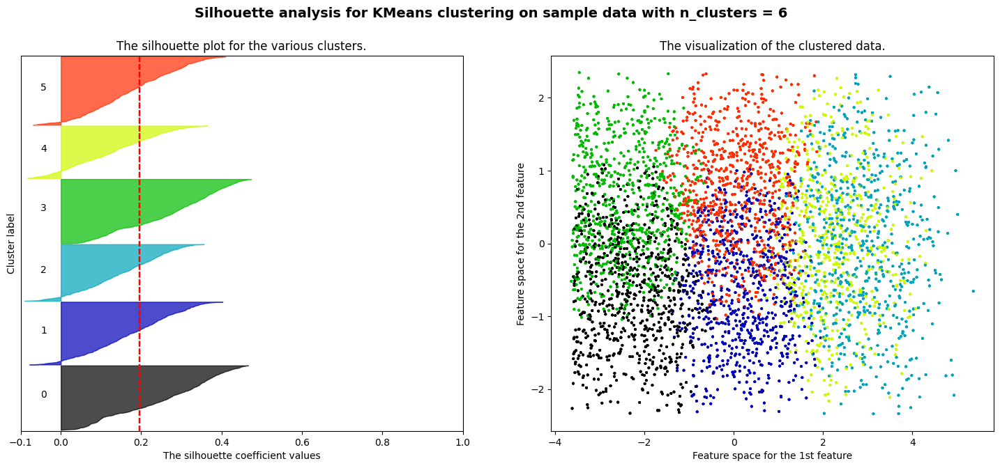

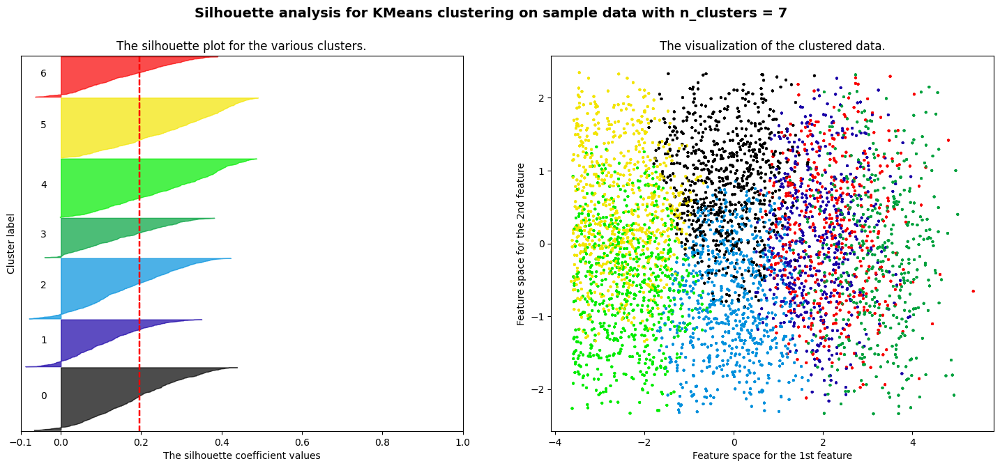

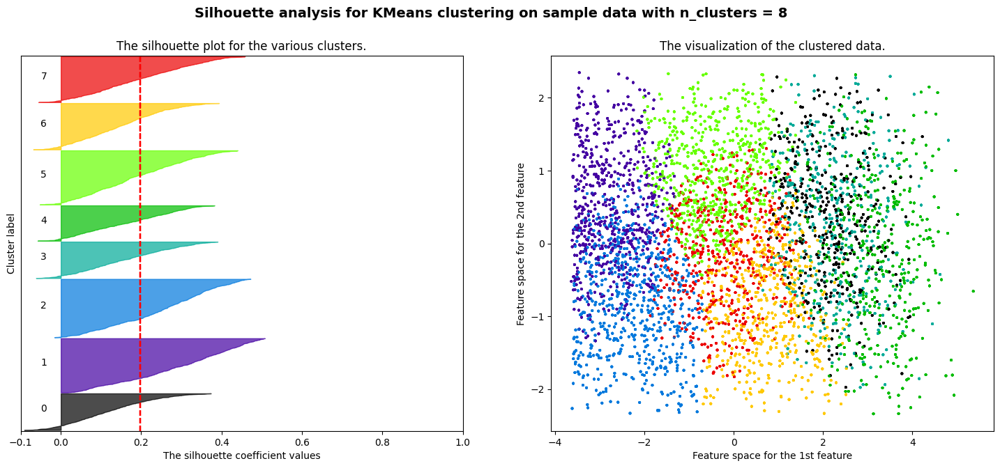

In [208]:
K = [3,4,5,6,7,8]
plot_silhouette(KMeans,K,X_tr.values,"KMeans")

Conclusion:

Based on the silhouette scores, the clustering algorithm performed relatively well across different numbers of clusters. The highest silhouette score is obtained when using 3 clusters, indicating that the data points are reasonably well-separated within their assigned clusters. As the number of clusters increases, the silhouette scores slightly decrease, but they still remain relatively high.

These results suggest that the data can be effectively clustered into 3

## MODEL DEFINITION

K-means is clustering algorithm used in machine learning and data analysis. It is an unsupervised learning algorithm that aims to partition a dataset into a predetermined number of clusters.

The main idea behind the K-means algorithm is to group similar data points together and separate dissimilar points into different clusters. It works by iteratively assigning data points to the nearest cluster centroid and updating the centroid based on the newly assigned points. The algorithm seeks to minimize the within-cluster sum of squared distances, also known as inertia or distortion.

K-means is a simple and efficient algorithm that scales well to large datasets. However, it has some limitations. It assumes that the clusters are spherical, equally sized, and have similar densities. K-means is also sensitive to the initial centroid positions and can get stuck in local optima.

# KMEANS TRAIN

In [209]:
# fit transform model KMeans cluster 3
k_3 = KMeans(n_clusters=3)
label3 = k_3.fit_predict(X_tr)

<Axes: xlabel='0', ylabel='1'>

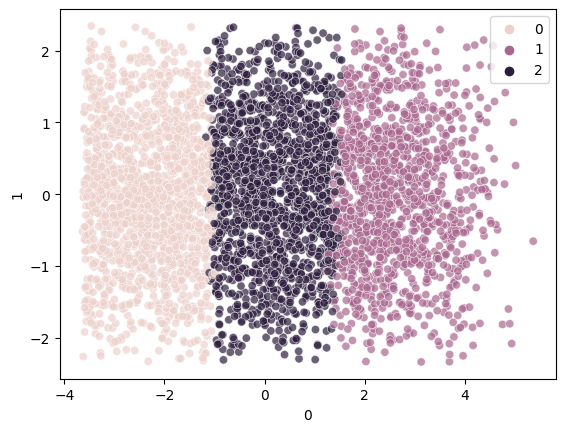

In [210]:
# visualize segmentation of 4 cluster in 2 PC's
sns.scatterplot(x=X_viz[0], y=X_viz[1], hue=label3, alpha=.7)

on the visual result cluster is perfectly separated into 3 cluster

# KMEANS IMPLEMENTATION

In [211]:
df_usd

,loan_id,no_of_dependents,education,self_employed,income_annum,loan_amount,loan_term,cibil_score,residential_assets_value,commercial_assets_value,luxury_assets_value,bank_asset_value,loan_status
0,1,2,Graduate,No,116959.064327,364278.752437,12,778,29239.766082,214424.951267,276559.454191,97465.886940,Approved
1,2,0,Not Graduate,Yes,49951.267057,148635.477583,8,417,32894.736842,26803.118908,107212.475634,40204.678363,Rejected
2,3,3,Graduate,No,110867.446394,361842.105263,20,506,86500.974659,54824.561404,405701.754386,155945.419103,Rejected
3,4,3,Graduate,No,99902.534113,374025.341131,8,467,221734.892788,40204.678363,283869.395712,96247.563353,Rejected
4,5,5,Not Graduate,Yes,119395.711501,294834.307992,20,382,151072.124756,99902.534113,358187.134503,60916.179337,Rejected
...,...,...,...,...,...,...,...,...,...,...,...,...,...
4264,4265,5,Graduate,Yes,12183.235867,28021.442495,12,317,34113.060429,6091.617934,40204.678363,9746.588694,Rejected
4265,4266,0,Not Graduate,Yes,40204.678363,137670.565302,20,559,51169.590643,35331.384016,134015.594542,23148.148148,Approved
4266,4267,2,Not Graduate,No,79191.033138,291179.337232,18,457,14619.883041,151072.124756,220516.569201,88937.621832,Rejected
4267,4268,1,Not Graduate,No,49951.267057,155945.419103,8,780,99902.534113,8528.265107,171783.625731,70662.768031,Approved


In [212]:
# manipulate new column contain label
df_usd['cluster'] = label3

In [213]:
df_usd

,loan_id,no_of_dependents,education,self_employed,income_annum,loan_amount,loan_term,cibil_score,residential_assets_value,commercial_assets_value,luxury_assets_value,bank_asset_value,loan_status,cluster
0,1,2,Graduate,No,116959.064327,364278.752437,12,778,29239.766082,214424.951267,276559.454191,97465.886940,Approved,1
1,2,0,Not Graduate,Yes,49951.267057,148635.477583,8,417,32894.736842,26803.118908,107212.475634,40204.678363,Rejected,0
2,3,3,Graduate,No,110867.446394,361842.105263,20,506,86500.974659,54824.561404,405701.754386,155945.419103,Rejected,1
3,4,3,Graduate,No,99902.534113,374025.341131,8,467,221734.892788,40204.678363,283869.395712,96247.563353,Rejected,1
4,5,5,Not Graduate,Yes,119395.711501,294834.307992,20,382,151072.124756,99902.534113,358187.134503,60916.179337,Rejected,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4264,4265,5,Graduate,Yes,12183.235867,28021.442495,12,317,34113.060429,6091.617934,40204.678363,9746.588694,Rejected,0
4265,4266,0,Not Graduate,Yes,40204.678363,137670.565302,20,559,51169.590643,35331.384016,134015.594542,23148.148148,Approved,0
4266,4267,2,Not Graduate,No,79191.033138,291179.337232,18,457,14619.883041,151072.124756,220516.569201,88937.621832,Rejected,2
4267,4268,1,Not Graduate,No,49951.267057,155945.419103,8,780,99902.534113,8528.265107,171783.625731,70662.768031,Approved,2


In [214]:
# define EDA cluster 0
cluster_0 = df_usd[df_usd['cluster'] == 0]
cluster_0 = cluster_0[num_col]
cluster_0['cluster'] = 0

In [215]:
# define EDA cluster 1
cluster_1 = df_usd[df_usd['cluster'] == 1]
cluster_1 = cluster_1[num_col]
cluster_1['cluster'] = 1

In [216]:
# define EDA cluster 2
cluster_2 = df_usd[df_usd['cluster'] == 2]
cluster_2 = cluster_2[num_col]
cluster_2['cluster'] = 2

DataPrep Report
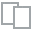
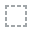
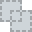
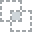
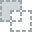
...
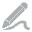
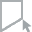
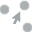
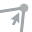
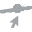

In [217]:
create_report(cluster_0)

DataPrep Report
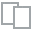
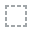
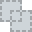
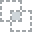
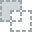
...
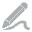
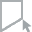
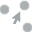
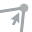
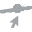

In [218]:
create_report(cluster_1)

DataPrep Report
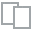
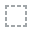
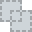
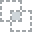
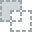
...
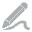
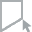
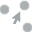
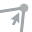
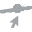

In [219]:
create_report(cluster_2)

In [220]:
# report summary EDA each cluster
cluster_0_summ = {
    'Category': ['income_amount', 'loan_amount', 'loan_term', 'cibil score',
                 'residential_assets_values', 'commercial_assets_values', 'luxury_assets_values', 'bank_asset_value'],
    'Mean_cluster_0': [66665.4841, 195961.0473, 10.7241, 591.6545,
             87613.4924, 59355.5426, 196785.7107, 64419.4431],
    'Minimum_cluster_0': [35331.384, 87719.2982, 2, 300,
                -1218.3236, 0, 88937.6218, 20711.501],
    'Maximum_cluster_0': [115740.7407, 400828.46, 20, 900,
                261939.5712, 180311.8908, 453216.3743, 144980.5068]
}

cluster_0_summ = pd.DataFrame(cluster_0_summ)
cluster_0_summ.set_index('Category', inplace=True)
cluster_0_summ

,Mean_cluster_0,Minimum_cluster_0,Maximum_cluster_0
Category,,,
income_amount,66665.4841,35331.3840,115740.7407
loan_amount,195961.0473,87719.2982,400828.4600
loan_term,10.7241,2.0000,20.0000
cibil score,591.6545,300.0000,900.0000
residential_assets_values,87613.4924,-1218.3236,261939.5712
commercial_assets_values,59355.5426,0.0000,180311.8908
luxury_assets_values,196785.7107,88937.6218,453216.3743
bank_asset_value,64419.4431,20711.5010,144980.5068


- Income: The customers in Cluster 0 have an average income of approximately 66,665, with some earning as little as 35,331 and others as much as 115,740.

- Loan Amount: The average loan amount requested by customers in this cluster is around 195,961, ranging from a minimum of 87,719 to a maximum of 400,828.

- Loan Term: Customers in this cluster generally request loans with an average term of 10.72 years, varying between a minimum of 2 years and a maximum of 20 years.

- CIBIL Score: The average CIBIL score for customers in Cluster 0 is approximately 591, with scores ranging from a minimum of 300 to a maximum of 900. This indicates a wide variation in creditworthiness within this cluster.

- Asset Values: Customers in this cluster possess various asset types, such as residential, commercial, and luxury assets. The average values for these assets are 87,613, 59,355, and $96,785, respectively. Notably, some customers have negative residential assets values, which might indicate outstanding debts or mortgage-related issues.

- Bank Asset Value: The average bank asset value for customers in this cluster is 64,419, ranging from a minimum of 20,711 to a maximum of 144,980.

In [221]:
cluster_1_summ = {
    'Category': ['income_amount', 'loan_amount', 'loan_term', 'cibil score',
                 'residential_assets_values', 'commercial_assets_values', 'luxury_assets_values', 'bank_asset_value'],
    'Mean_cluster_1': [23315.2887, 68683.2994, 10.959, 609.8426,
             32739.886, 20641.8591, 67570.6677, 21695.5001],
    'Minimum_cluster_1': [2436.6472, 3654.9708, 2, 300,
                -1218.3236, 0, 3654.9708, 0],
    'Maximum_cluster_1': [54824.5614, 198586.7446, 20, 900,
                132797.271, 81627.6803, 188840.1559, 69444.4444]
}

cluster_1_summ = pd.DataFrame(cluster_1_summ)
cluster_1_summ.set_index('Category', inplace=True)
cluster_1_summ

,Mean_cluster_1,Minimum_cluster_1,Maximum_cluster_1
Category,,,
income_amount,23315.2887,2436.6472,54824.5614
loan_amount,68683.2994,3654.9708,198586.7446
loan_term,10.9590,2.0000,20.0000
cibil score,609.8426,300.0000,900.0000
residential_assets_values,32739.8860,-1218.3236,132797.2710
commercial_assets_values,20641.8591,0.0000,81627.6803
luxury_assets_values,67570.6677,3654.9708,188840.1559
bank_asset_value,21695.5001,0.0000,69444.4444


- Income: Customers in Cluster 1 have an average income of approximately 23,315, with incomes ranging from as low as 2,436 to as high as 54,824. This suggests that this cluster includes individuals with relatively lower income levels.

- Loan Amount: The average loan amount requested by customers in this cluster is around 68,683, varying from a minimum of 3,654 to a maximum of 198,586. This indicates that customers in this cluster typically apply for smaller to moderate-sized loans.

- Loan Term: Customers in this cluster request loans with an average term of 10.96 years, with loan terms ranging from a minimum of 2 years to a maximum of 20 years.

- CIBIL Score: The average CIBIL score for customers in Cluster 1 is approximately 609, with scores ranging from a minimum of 300 to a maximum of 900. This suggests that customers in this cluster have relatively moderate to good creditworthiness.

- Asset Values: Customers in this cluster possess various asset types, such as residential, commercial, and luxury assets. The average values for these assets are 32,739, 20,641, and 67,570, respectively. Notably, some customers have negative residential assets values, which might indicate outstanding debts or mortgage-related issues.

- Bank Asset Value: The average bank asset value for customers in this cluster is 21,695, ranging from a minimum of 0 to a maximum of 69,444.

In [222]:
cluster_2_summ = {
    'Category': ['income_amount', 'loan_amount', 'loan_term', 'cibil score',
                 'residential_assets_values', 'commercial_assets_values', 'luxury_assets_values', 'bank_asset_value'],
    'Mean_cluster_2': [102021.5755, 310927, 11.0559, 598.4868,
             166748.0218, 111027.7521, 310919.9866, 103369.1456],
    'Minimum_cluster_2': [65789.4737, 151072.1248, 2, 300,
                -1218.3236, 0, 160818.7135, 43859.6491],
    'Maximum_cluster_2': [120614.0351, 481237.8168, 20, 900,
                354532.1637, 236354.7758, 477582.846, 179093.5673]
}

cluster_2_summ = pd.DataFrame(cluster_2_summ)
cluster_2_summ.set_index('Category', inplace=True)
cluster_2_summ

,Mean_cluster_2,Minimum_cluster_2,Maximum_cluster_2
Category,,,
income_amount,102021.5755,65789.4737,120614.0351
loan_amount,310927.0000,151072.1248,481237.8168
loan_term,11.0559,2.0000,20.0000
cibil score,598.4868,300.0000,900.0000
residential_assets_values,166748.0218,-1218.3236,354532.1637
commercial_assets_values,111027.7521,0.0000,236354.7758
luxury_assets_values,310919.9866,160818.7135,477582.8460
bank_asset_value,103369.1456,43859.6491,179093.5673


- Income: Customers in Cluster 2 have an average income of approximately $102,021, with incomes ranging from 65,789 to 120,614. This indicates that this cluster includes individuals with relatively higher income levels compared to the other clusters.

- Loan Amount: The average loan amount requested by customers in this cluster is around 310,927, varying from 151,072 to 481,238. This suggests that customers in this cluster typically apply for larger loan amounts.

- Loan Term: Customers in this cluster request loans with an average term of 11.06 years, with loan terms ranging from a minimum of 2 years to a maximum of 20 years.

- CIBIL Score: The average CIBIL score for customers in Cluster 2 is approximately 598, with scores ranging from a minimum of 300 to a maximum of 900. This indicates that customers in this cluster have moderate to good creditworthiness.

- Asset Values: Customers in this cluster possess various asset types, such as residential, commercial, and luxury assets. The average values for these assets are 166,748, 111,028, and 310,920, respectively. Notably, some customers have negative residential assets values, which might indicate outstanding debts or mortgage-related issues.

- Bank Asset Value: The average bank asset value for customers in this cluster is 103,369, ranging from a minimum of 43,860 to a maximum of 179,094.

In [223]:
cluster_summary = pd.concat([cluster_0_summ,cluster_1_summ['Mean_cluster_1'],cluster_1_summ['Minimum_cluster_1'],cluster_1_summ['Maximum_cluster_1'],cluster_2_summ['Mean_cluster_2'],cluster_2_summ['Minimum_cluster_2'],cluster_2_summ['Maximum_cluster_2']], axis=1)
cluster_summary

,Mean_cluster_0,Minimum_cluster_0,Maximum_cluster_0,Mean_cluster_1,Minimum_cluster_1,Maximum_cluster_1,Mean_cluster_2,Minimum_cluster_2,Maximum_cluster_2
Category,,,,,,,,,
income_amount,66665.4841,35331.3840,115740.7407,23315.2887,2436.6472,54824.5614,102021.5755,65789.4737,120614.0351
loan_amount,195961.0473,87719.2982,400828.4600,68683.2994,3654.9708,198586.7446,310927.0000,151072.1248,481237.8168
loan_term,10.7241,2.0000,20.0000,10.9590,2.0000,20.0000,11.0559,2.0000,20.0000
cibil score,591.6545,300.0000,900.0000,609.8426,300.0000,900.0000,598.4868,300.0000,900.0000
residential_assets_values,87613.4924,-1218.3236,261939.5712,32739.8860,-1218.3236,132797.2710,166748.0218,-1218.3236,354532.1637
commercial_assets_values,59355.5426,0.0000,180311.8908,20641.8591,0.0000,81627.6803,111027.7521,0.0000,236354.7758
luxury_assets_values,196785.7107,88937.6218,453216.3743,67570.6677,3654.9708,188840.1559,310919.9866,160818.7135,477582.8460
bank_asset_value,64419.4431,20711.5010,144980.5068,21695.5001,0.0000,69444.4444,103369.1456,43859.6491,179093.5673


1. Low-Risk Customers:
- Cluster 1: These customers have relatively low mean values for income_amount, loan_amount, residential_assets_values, luxury_assets_values, and bank_asset_value. They also have a higher mean value for cibil score, indicating good creditworthiness.


---


2. Moderate-Risk Customers:
- Cluster 0: These customers have moderate mean values for income_amount, loan_amount, residential_assets_values, commercial_assets_values, luxury_assets_values, and bank_asset_value. Their cibil score is also moderate, indicating average creditworthiness.


---



3. High-Risk Customers:

- Cluster 2: These customers have the highest mean values for income_amount, loan_amount, residential_assets_values, commercial_assets_values, luxury_assets_values, and bank_asset_value. However, their cibil score is relatively lower compared to other clusters, indicating potential higher risk.

In [224]:
df_usd['cluster'] = df_usd['cluster'].replace({0 : 'Moderate-Risk Customers', 1 : 'Low-Risk Customers', 2 : 'High-Risk Customers'})

In [225]:
df_usd

,loan_id,no_of_dependents,education,self_employed,income_annum,loan_amount,loan_term,cibil_score,residential_assets_value,commercial_assets_value,luxury_assets_value,bank_asset_value,loan_status,cluster
0,1,2,Graduate,No,116959.064327,364278.752437,12,778,29239.766082,214424.951267,276559.454191,97465.886940,Approved,Low-Risk Customers
1,2,0,Not Graduate,Yes,49951.267057,148635.477583,8,417,32894.736842,26803.118908,107212.475634,40204.678363,Rejected,Moderate-Risk Customers
2,3,3,Graduate,No,110867.446394,361842.105263,20,506,86500.974659,54824.561404,405701.754386,155945.419103,Rejected,Low-Risk Customers
3,4,3,Graduate,No,99902.534113,374025.341131,8,467,221734.892788,40204.678363,283869.395712,96247.563353,Rejected,Low-Risk Customers
4,5,5,Not Graduate,Yes,119395.711501,294834.307992,20,382,151072.124756,99902.534113,358187.134503,60916.179337,Rejected,Low-Risk Customers
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4264,4265,5,Graduate,Yes,12183.235867,28021.442495,12,317,34113.060429,6091.617934,40204.678363,9746.588694,Rejected,Moderate-Risk Customers
4265,4266,0,Not Graduate,Yes,40204.678363,137670.565302,20,559,51169.590643,35331.384016,134015.594542,23148.148148,Approved,Moderate-Risk Customers
4266,4267,2,Not Graduate,No,79191.033138,291179.337232,18,457,14619.883041,151072.124756,220516.569201,88937.621832,Rejected,High-Risk Customers
4267,4268,1,Not Graduate,No,49951.267057,155945.419103,8,780,99902.534113,8528.265107,171783.625731,70662.768031,Approved,High-Risk Customers


In [226]:
cluster = Pipeline([
    ("scaler", StandardScaler()),
    ("pca", PCA(n_components=.90)),

])

# FEATURE ENGINEERING

## IMBALANCE DATA

In [227]:
X = df_usd.drop([' loan_status'],axis=1)
y = df_usd[' loan_status']

In [228]:
# Check Target

y.value_counts()

 Approved    2656
 Rejected    1613
Name:  loan_status, dtype: int64

it show y target of the data is imbalance, next step will apply SMOTE-NC

In [229]:
# SMOTE-NC

from imblearn.over_sampling import SMOTENC

smotenc = SMOTENC([2, 3, 12], random_state = 42)
X_train_balanced, y_train_balanced = smotenc.fit_resample(X, y)
y_train_balanced.value_counts()

 Approved    2656
 Rejected    2656
Name:  loan_status, dtype: int64

data result already balance

In [230]:
X_train_balanced[' loan_status'] = y_train_balanced

In [231]:
df_balance = X_train_balanced
df_balance

,loan_id,no_of_dependents,education,self_employed,income_annum,loan_amount,loan_term,cibil_score,residential_assets_value,commercial_assets_value,luxury_assets_value,bank_asset_value,cluster,loan_status
0,1,2,Graduate,No,116959.064327,364278.752437,12,778,29239.766082,214424.951267,276559.454191,97465.886940,Low-Risk Customers,Approved
1,2,0,Not Graduate,Yes,49951.267057,148635.477583,8,417,32894.736842,26803.118908,107212.475634,40204.678363,Moderate-Risk Customers,Rejected
2,3,3,Graduate,No,110867.446394,361842.105263,20,506,86500.974659,54824.561404,405701.754386,155945.419103,Low-Risk Customers,Rejected
3,4,3,Graduate,No,99902.534113,374025.341131,8,467,221734.892788,40204.678363,283869.395712,96247.563353,Low-Risk Customers,Rejected
4,5,5,Not Graduate,Yes,119395.711501,294834.307992,20,382,151072.124756,99902.534113,358187.134503,60916.179337,Low-Risk Customers,Rejected
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5307,1719,4,Not Graduate,Yes,81706.594322,222464.206046,5,381,59855.683770,106471.197007,280068.562300,61763.863611,High-Risk Customers,Rejected
5308,2632,0,Not Graduate,Yes,115367.973195,350963.555806,15,499,298962.067247,63239.147436,394882.251502,79477.437860,Low-Risk Customers,Rejected
5309,1315,4,Not Graduate,No,7309.941520,26301.884127,5,367,1146.372246,0.000000,22574.962025,3869.612481,Moderate-Risk Customers,Rejected
5310,2499,0,Graduate,Yes,103135.601702,339348.219746,10,496,26475.987593,85777.629620,245520.177268,84852.184751,Low-Risk Customers,Rejected


## SPLIT DATA

In [232]:
X = df_balance.drop([' loan_status','loan_id'],axis=1)
y = df_balance[' loan_status']
X_train, X_test, y_train, y_test = train_test_split(X_train_balanced, y_train_balanced, test_size=0.2, stratify=y, random_state=0)

In [233]:
# shape information
for i in [X_train, X_test, y_train, y_test]:
    print(i.shape)

(4249, 14)
(1063, 14)
(4249,)
(1063,)


In [234]:
num_col_eda = [' no_of_dependents',' income_annum',' loan_amount',' loan_term',' cibil_score',' residential_assets_value',' commercial_assets_value', ' luxury_assets_value', ' bank_asset_value']
cat_col_eda = [' education',' self_employed','cluster']

## EDA FOR MODELLING

In [235]:
X_train_eda = X_train.copy()
X_train_eda.head()

,loan_id,no_of_dependents,education,self_employed,income_annum,loan_amount,loan_term,cibil_score,residential_assets_value,commercial_assets_value,luxury_assets_value,bank_asset_value,cluster,loan_status
4163,4164,3,Graduate,No,108430.799220,297270.955166,10,774,136452.241715,74317.738791,382553.606238,88937.621832,Low-Risk Customers,Approved
1455,1456,4,Graduate,No,57261.208577,126705.653021,6,373,82846.003899,104775.828460,174220.272904,65789.473684,High-Risk Customers,Rejected
3069,3070,5,Graduate,Yes,105994.152047,224171.539961,12,394,229044.834308,38986.354776,299707.602339,146198.830409,Low-Risk Customers,Rejected
1949,1950,1,Not Graduate,No,75536.062378,257066.276803,10,467,190058.479532,127923.976608,286306.042885,64571.150097,Low-Risk Customers,Rejected
1907,1908,2,Graduate,No,38986.354776,76754.385965,10,339,3654.970760,59697.855750,88937.621832,32894.736842,Moderate-Risk Customers,Rejected


## HANDLING OUTLIERS

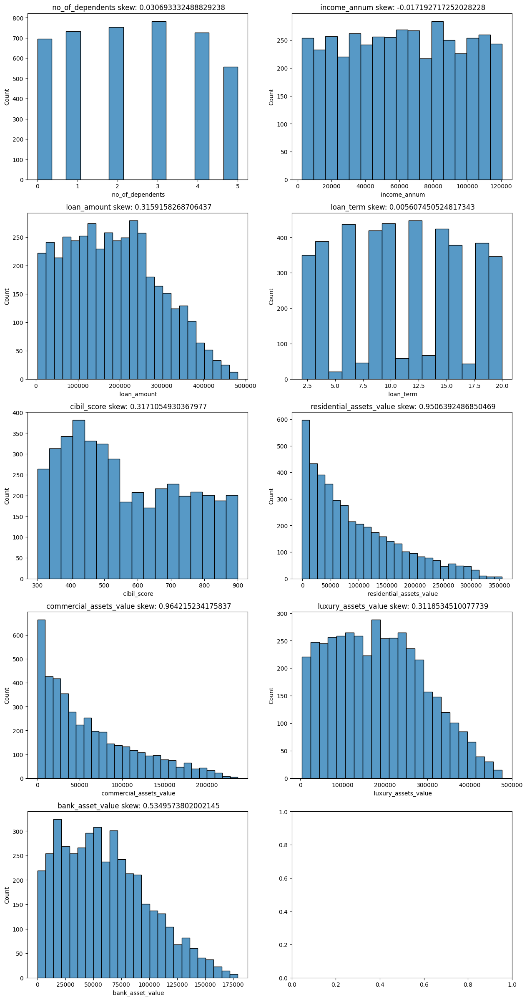

In [236]:
# ploting numerical columns to find skewness
fig, ax = plt.subplots(nrows=5,ncols=2, figsize=[15,30])
ax = ax.flatten()

for idx, col in enumerate(num_col_eda):
    sns.histplot(X_train_eda[col], ax=ax[idx])
    ax[idx].set_title(f'{num_col_eda[idx]} skew: {X_train_eda[col].skew()}')

In [237]:
# define function for printing skewness
def print_skew(data,columns):
  for col in columns:
    if -0.5 <= data[col].skew() <= 0.5:
      print(f'Column {col} :{data[col].skew()} is normal distribution')
    elif data[col].skew() > 0.5:
      print(f'Column {col} :{data[col].skew()} right skewed')
    elif data[col].skew() < -0.5:
      print(f'Column {col} :{data[col].skew()} left skewed')

In [238]:
print_skew(X_train_eda,num_col_eda)

Column  no_of_dependents :0.030693332488829238 is normal distribution
Column  income_annum :-0.017192717252028228 is normal distribution
Column  loan_amount :0.3159158268706437 is normal distribution
Column  loan_term :0.005607450524817343 is normal distribution
Column  cibil_score :0.3171054930367977 is normal distribution
Column  residential_assets_value :0.9506392486850469 right skewed
Column  commercial_assets_value :0.964215234175837 right skewed
Column  luxury_assets_value :0.3118534510077739 is normal distribution
Column  bank_asset_value :0.5349573802002145 right skewed


In [239]:
# define function for iqr and gaussian
iqr_feature_1 = []
iqr_feature_2 = []
gaussian_feature = []
def iqr_or_gaussian(data,columns):
  for col in columns:
    if -0.5 <= data[col].skew() <= 0.5:
      gaussian_feature.append(col)
    elif data[col].skew() > 0.5 and data[col].skew() <= 3 :
      iqr_feature_2.append(col)
    elif data[col].skew() > 3 :
      iqr_feature_1.append(col)
    elif data[col].skew() < -0.5 and data[col].skew() <= -3 :
      iqr_feature_2.append(col)
    elif data[col].skew() > -3 :
      iqr_feature_1.append(col)

In [240]:
iqr_or_gaussian(X_train_eda,num_col_eda)

In [241]:
iqr_feature_1

[]

In [242]:
iqr_feature_2

[' residential_assets_value', ' commercial_assets_value', ' bank_asset_value']

In [243]:
gaussian_feature

[' no_of_dependents',
 ' income_annum',
 ' loan_amount',
 ' loan_term',
 ' cibil_score',
 ' luxury_assets_value']

In [244]:
# define function for print percentage outliers2
def percent_features2(data,columns):
  for col in columns:
    upper = data[col].mean() + (1.5 * data[col].std())
    lower = data[col].mean() - (1.5 * data[col].std())
    outlier = data[(X_train_eda[col] <= lower) | (X_train_eda[col] >= upper)]
    print('percentage', X_train_eda[col].name, ':', len(outlier)/data.shape[0] * 100, '%')

In [245]:
# define function for print percentage outliers3
def gaussian_features(data,columns):
  for col in columns:
    upper = data[col].mean() + (3 * data[col].std())
    lower = data[col].mean() - (3 * data[col].std())
    outlier = data[(data[col] <= lower) | (data[col] >= upper)]
    print('percentage', X_train_eda[col].name, ':', len(outlier)/data.shape[0] * 100, '%')

In [246]:
percent_features2(X_train_eda, iqr_feature_2)

percentage  residential_assets_value : 10.237702988938574 %
percentage  commercial_assets_value : 10.661332078136033 %
percentage  bank_asset_value : 9.74346905154154 %


In [247]:
gaussian_features(X_train_eda, gaussian_feature)

percentage  no_of_dependents : 0.0 %
percentage  income_annum : 0.0 %
percentage  loan_amount : 0.0 %
percentage  loan_term : 0.0 %
percentage  cibil_score : 0.0 %
percentage  luxury_assets_value : 0.0 %


Gaussian or normal distribution column doesnt have outliers

In [248]:
# resolve any duplication variables
iqr_feature_2 = list(set(iqr_feature_2))

In [249]:
# Trimming outliers using IQR method with threshold = 1.5
wins_2 = Winsorizer(capping_method='iqr', tail='both', fold=3,
                  variables=iqr_feature_2, missing_values='ignore')

X_train_eda = wins_2.fit_transform(X_train_eda)
X_train_eda.describe()

,loan_id,no_of_dependents,income_annum,loan_amount,loan_term,cibil_score,residential_assets_value,commercial_assets_value,luxury_assets_value,bank_asset_value
count,4249.000000,4249.000000,4249.000000,4249.000000,4249.000000,4249.000000,4249.000000,4249.000000,4249.000000,4249.000000
mean,2128.938338,2.420099,61750.612203,184176.366720,10.962815,566.169452,92158.003086,61050.549220,184234.822734,60474.634820
std,1193.403976,1.642990,33991.557428,109270.331634,5.445504,171.879285,79294.972228,53700.771258,109693.205642,38720.784606
min,2.000000,0.000000,2436.647173,3654.970760,2.000000,300.000000,-1218.323587,0.000000,3654.970760,0.000000
25%,1122.000000,1.000000,32894.736842,94186.978726,6.000000,419.000000,26803.118908,17056.530214,92357.491533,28035.395102
50%,2116.000000,2.000000,62134.502924,177875.243665,11.000000,532.000000,70662.768031,45077.972710,177875.243665,56042.884990
75%,3129.000000,4.000000,91374.269006,259502.923977,16.000000,712.000000,140107.212476,92592.592593,261939.571150,86500.974659
max,4269.000000,5.000000,120614.035088,481237.816764,20.000000,900.000000,354532.163743,236354.775828,476364.522417,179093.567251


## HANDLING MISSING VALUE

In [250]:
X_train_eda.isnull().sum()

loan_id                      0
 no_of_dependents            0
 education                   0
 self_employed               0
 income_annum                0
 loan_amount                 0
 loan_term                   0
 cibil_score                 0
 residential_assets_value    0
 commercial_assets_value     0
 luxury_assets_value         0
 bank_asset_value            0
cluster                      0
 loan_status                 0
dtype: int64

There is no missing values

## SCALING NUMERICAL

In [251]:
# Scaling numerical for standarize the scale of values
scaler = StandardScaler()

X_train_eda[num_col] = scaler.fit_transform(X_train_eda[num_col])
X_train_eda

,loan_id,no_of_dependents,education,self_employed,income_annum,loan_amount,loan_term,cibil_score,residential_assets_value,commercial_assets_value,luxury_assets_value,bank_asset_value,cluster,loan_status
4163,4164,3,Graduate,No,1.373449,1.035120,-0.176830,1.209308,0.558667,0.247087,1.808153,0.735169,Low-Risk Customers,Approved
1455,1456,4,Graduate,No,-0.132090,-0.526012,-0.911467,-1.123999,-0.117449,0.814335,-0.091307,0.137277,High-Risk Customers,Rejected
3069,3070,5,Graduate,Yes,1.301757,0.366064,0.190489,-1.001806,1.726502,-0.410921,1.052812,2.214167,Low-Risk Customers,Rejected
1949,1950,1,Not Graduate,No,0.405603,0.667139,-0.176830,-0.577039,1.234782,1.245444,0.930625,0.105809,Low-Risk Customers,Rejected
1907,1908,2,Graduate,No,-0.669782,-0.983200,-0.176830,-1.321836,-1.116255,-0.025192,-0.868863,-0.712360,Moderate-Risk Customers,Rejected
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2181,2182,3,Not Graduate,No,0.764065,0.633686,0.925126,-0.035898,-0.839663,1.290824,0.664034,-0.429148,High-Risk Customers,Approved
2299,2300,2,Not Graduate,No,-1.494244,-1.462691,0.557807,-1.333473,-0.901128,-1.136999,-1.446477,-1.373189,Moderate-Risk Customers,Rejected
671,672,4,Graduate,No,0.764065,0.867856,1.292445,0.528518,1.081119,-1.046239,0.253040,1.207190,High-Risk Customers,Approved
1578,1579,3,Graduate,Yes,-1.135782,-0.893993,-0.911467,0.097932,-1.100889,-0.501681,-0.957727,-0.932636,Moderate-Risk Customers,Approved


## ENCODING CATEGORICAL

In [252]:
X_train_eda[cat_col_eda]

,education,self_employed,cluster
4163,Graduate,No,Low-Risk Customers
1455,Graduate,No,High-Risk Customers
3069,Graduate,Yes,Low-Risk Customers
1949,Not Graduate,No,Low-Risk Customers
1907,Graduate,No,Moderate-Risk Customers
...,...,...,...
2181,Not Graduate,No,High-Risk Customers
2299,Not Graduate,No,Moderate-Risk Customers
671,Graduate,No,High-Risk Customers
1578,Graduate,Yes,Moderate-Risk Customers


- ordinal encoding (binary values) : ` education`, ` self_employed` and `cluster`

In [253]:
# encoding Taste, Odor, Fat -> ordinal
edu_cat = [' Not Graduate', ' Graduate']
employed_cat = [' No', ' Yes']
cluster_cat = ['Low-Risk Customers', 'Moderate-Risk Customers', 'High-Risk Customers']

ord_enc = OrdinalEncoder(categories=[edu_cat, employed_cat, cluster_cat])
cat_ord = pd.DataFrame(ord_enc.fit_transform(X_train_eda[[' education', ' self_employed', 'cluster']]))

cat_ord.columns = [' education', ' self_employed', 'cluster']
review = pd.concat([X_train_eda[[' education', ' self_employed', 'cluster']].reset_index(drop=True), cat_ord], axis=1)

review.sample(5)

,education,self_employed,cluster,education,self_employed,cluster
90,Not Graduate,No,Moderate-Risk Customers,0.0,0.0,1.0
4168,Graduate,Yes,Moderate-Risk Customers,1.0,1.0,1.0
1843,Not Graduate,Yes,Low-Risk Customers,0.0,1.0,0.0
593,Graduate,Yes,High-Risk Customers,1.0,1.0,2.0
3121,Not Graduate,No,Low-Risk Customers,0.0,0.0,0.0


In [254]:
X_train_eda = pd.concat([X_train_eda[num_col].reset_index(drop=True), cat_ord], axis=1)
X_train_eda.shape

(4249, 11)

In [255]:
X_train_eda.head()

,income_annum,loan_amount,loan_term,cibil_score,residential_assets_value,commercial_assets_value,luxury_assets_value,bank_asset_value,education,self_employed,cluster
0,1.373449,1.035120,-0.176830,1.209308,0.558667,0.247087,1.808153,0.735169,1.0,0.0,0.0
1,-0.132090,-0.526012,-0.911467,-1.123999,-0.117449,0.814335,-0.091307,0.137277,1.0,0.0,2.0
2,1.301757,0.366064,0.190489,-1.001806,1.726502,-0.410921,1.052812,2.214167,1.0,1.0,0.0
3,0.405603,0.667139,-0.176830,-0.577039,1.234782,1.245444,0.930625,0.105809,0.0,0.0,0.0
4,-0.669782,-0.983200,-0.176830,-1.321836,-1.116255,-0.025192,-0.868863,-0.712360,1.0,0.0,1.0


In [256]:
y_train_eda = y_train.replace({' Rejected' : 0, ' Approved' : 1})

In [257]:
from sklearn.feature_selection import SequentialFeatureSelector
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import make_scorer, recall_score

custom_recall_scorer = make_scorer(recall_score, pos_label=1)
skfold=StratifiedKFold(n_splits=20)

# initialize the Sequential Feature Selector with Random Forest Classifier as estimator
sfs = SequentialFeatureSelector(LogisticRegression(max_iter=100000,random_state=0),n_features_to_select="auto",
                                direction='forward',scoring=custom_recall_scorer,cv=skfold)


# fit the Sequential Feature Selector to the data
sfs.fit(X_train_eda, y_train_eda)
result_sfs = sfs.transform(X_train_eda)
result = pd.DataFrame(result_sfs,columns = sfs.get_feature_names_out())
result.head()

,income_annum,cibil_score,residential_assets_value,commercial_assets_value,education
0,1.373449,1.209308,0.558667,0.247087,1.0
1,-0.132090,-1.123999,-0.117449,0.814335,1.0
2,1.301757,-1.001806,1.726502,-0.410921,1.0
3,0.405603,-0.577039,1.234782,1.245444,0.0
4,-0.669782,-1.321836,-1.116255,-0.025192,1.0


In [258]:
# Calling original features
X_before_columns = X_train.columns
X_before_columns

Index(['loan_id', ' no_of_dependents', ' education', ' self_employed',
       ' income_annum', ' loan_amount', ' loan_term', ' cibil_score',
       ' residential_assets_value', ' commercial_assets_value',
       ' luxury_assets_value', ' bank_asset_value', 'cluster', ' loan_status'],
      dtype='object')

In [259]:
# Feature after feature selection
X_after_columns = result.columns
X_after_columns

Index([' income_annum', ' cibil_score', ' residential_assets_value',
       ' commercial_assets_value', ' education'],
      dtype='object')

In [260]:
# Feature not included for modeling
for item in X_before_columns:
    if item not in X_after_columns:
      print('After feature selection using Recursive feature elimination method:', {item}, 'is not included in modeling')

After feature selection using Recursive feature elimination method: {'loan_id'} is not included in modeling
After feature selection using Recursive feature elimination method: {' no_of_dependents'} is not included in modeling
After feature selection using Recursive feature elimination method: {' self_employed'} is not included in modeling
After feature selection using Recursive feature elimination method: {' loan_amount'} is not included in modeling
After feature selection using Recursive feature elimination method: {' loan_term'} is not included in modeling
After feature selection using Recursive feature elimination method: {' luxury_assets_value'} is not included in modeling
After feature selection using Recursive feature elimination method: {' bank_asset_value'} is not included in modeling
After feature selection using Recursive feature elimination method: {'cluster'} is not included in modeling
After feature selection using Recursive feature elimination method: {' loan_status'} is 

In [261]:
# define function for iqr and gaussian cleaned
iqr_columns_1_cleaned = []
iqr_columns_2_cleaned = []
gaussian_columns_cleaned = []
def iqr_or_gaussian_cleaned(columns):
  for col in columns:
    if col in iqr_feature_1:
      iqr_columns_1_cleaned.append(col)
    elif col in iqr_feature_2:
      iqr_columns_2_cleaned.append(col)
    elif col in gaussian_feature:
      gaussian_columns_cleaned.append(col)

In [262]:
# process function
iqr_or_gaussian_cleaned(X_after_columns)

In [263]:
print(iqr_columns_1_cleaned)

[]


In [264]:
print(iqr_columns_2_cleaned)

[' residential_assets_value', ' commercial_assets_value']


In [265]:
print(gaussian_columns_cleaned)

[' income_annum', ' cibil_score']


In [266]:
gaussian_columns_cleaned

[' income_annum', ' cibil_score']

after feature selection the and all the columns trimming method only using wins_2 which IQR method with threshold = 1.5, gaussian will not use since has no outliers

## PREPROCESSING

In [267]:
## Building pipeline Gaussian
num_pipeline_2 = Pipeline([
        ('outlier_2', Winsorizer(capping_method='iqr', tail='both', fold=1.5)),
        ('imputer', SimpleImputer(strategy='median')),
        ('scalar', StandardScaler())
    ])

num_tr_2 = num_pipeline_2.fit_transform(X_train[iqr_columns_2_cleaned])

In [268]:
## Building pipeline Gaussian
num_pipeline_3 = Pipeline([
        ('outlier_3', Winsorizer(capping_method='gaussian', tail='both', fold=3)),
        ('imputer', SimpleImputer(strategy='median')),
        ('scalar', StandardScaler())
    ])

num_tr_3 = num_pipeline_3.fit_transform(X_train[gaussian_columns_cleaned])

In [269]:
## Building pipeline Categorical
cat_pipeline = Pipeline([
        ('imputer_1', SimpleImputer(strategy='most_frequent')),
        ('ordinal_enc', OrdinalEncoder(categories=[[' Not Graduate', ' Graduate'],['Low-Risk Customers', 'Moderate-Risk Customers', 'High-Risk Customers']]))
    ])

cat_1_tr = cat_pipeline.fit_transform(X_train[[' education', 'cluster']])

In [270]:
# Bulding full-pipeline
full_pipeline = ColumnTransformer([
        ("num_2", num_pipeline_2, iqr_columns_2_cleaned),
        ("num_3", num_pipeline_3, gaussian_columns_cleaned),
        ("categorical", cat_pipeline, [' education', 'cluster']),
    ])

train_tr = full_pipeline.fit_transform(X_train)

In [271]:
train_tr

array([[ 0.56300873,  0.25023878,  1.37344931,  1.20930808,  1.        ,
         0.        ],
       [-0.11636917,  0.82048107, -0.13208962, -1.12399924,  1.        ,
         2.        ],
       [ 1.73647963, -0.41124228,  1.30175698, -1.00180609,  1.        ,
         0.        ],
       ...,
       [ 1.08798255, -1.04991365,  0.7640645 ,  0.52851767,  1.        ,
         2.        ],
       [-1.10455519, -0.50248105, -1.13578224,  0.09793227,  1.        ,
         1.        ],
       [-0.6567834 , -0.52529074, -1.24332074,  0.81945374,  1.        ,
         1.        ]])

the Pipeline is succesfull run on Xtrain, since

In [272]:
# Implementing pipeline to X_test
test_tr= full_pipeline.transform(X_test)

In [273]:
test_tr

array([[ 2.38416805,  2.03872767,  1.1664685 , -1.13563669,  0.        ,
         0.        ],
       [-0.02372673, -0.02347752, -0.38301278,  0.87764096,  1.        ,
         2.        ],
       [-0.34797527,  1.59601059,  1.66021863, -0.41993394,  0.        ,
         0.        ],
       ...,
       [ 0.11523693, -0.45686167, -0.77732059,  1.22094553,  0.        ,
         1.        ],
       [ 0.12833626,  1.09073896,  0.83642385, -0.3268344 ,  1.        ,
         0.        ],
       [-1.02735316, -1.02710396, -1.60178239, -0.82142573,  1.        ,
         1.        ]])

In [274]:
y_test = y_test.replace({' Rejected' : 0, ' Approved' : 1})

# MODEL DEFINITION

**Classifier Models :**

1. **Logistic Regression:**
Logistic Regression is linear classification algorithm used for binary classification or multi-class classification tasks. It models the relationship between the input features and the probability of belonging to a particular class using the logistic function. Logistic Regression assumes a linear relationship between the features and the log-odds of the target class. It can handle both numerical and categorical features, and regularization techniques can be applied to prevent overfitting.

2. **Support Vector Classifier (SVC)**:
SVC, or Support Vector Classifier, is machine learning algorithm used for classification tasks. It is based on the concept of support vectors, which are data points that define the decision boundary between different classes. SVC aims to find the hyperplane that maximizes the margin between classes while minimizing classification errors. It can handle linearly separable as well as non-linearly separable data by using kernel functions to transform the data into higher-dimensional spaces. SVC can handle binary classification as well as multi-class classification problems.

3. **Decision Tree Classifier:**
The Decision Tree Classifier is a non-parametric supervised learning algorithm that uses a tree-like model for classification tasks. It partitions the feature space based on the input features and creates a flowchart-like structure of decision nodes and leaf nodes. Each internal node in the tree represents a feature test, and each branch represents the outcome of the test. The leaf nodes represent the class labels. Decision trees are interpretable, can handle both numerical and categorical features, and can capture complex interactions between features. However, they are prone to overfitting if not properly regularized.

4. **Random Forest Classifier:**
Random Forest Classifier is an ensemble learning method that combines multiple decision trees to make predictions. It constructs a collection of decision trees, each trained on a different random subset of the training data and using a random subset of the features. The final prediction is made by aggregating the predictions of all the individual trees. Random Forests are known for their robustness, scalability, and ability to handle high-dimensional datasets. They are less prone to overfitting compared to individual decision trees and can capture complex interactions between features. Additionally, Random Forests provide feature importance measures, allowing the identification of the most relevant features for prediction.

5. K-Nearest Neighbors (KNN):
K-Nearest Neighbors is algorithm for both classification and regression tasks. It operates by finding the k nearest data points in the training set to a given test point based on a distance metric (e.g., Euclidean distance) and assigns the majority class label (for classification) or calculates the average (for regression). KNN is a non-parametric algorithm, meaning it doesn't make assumptions about the underlying data distribution. KNN is easy to understand and implement, but its performance can be sensitive to the choice of k and the distance metric.

6. Naive Bayes:
Naive Bayes is a probabilistic classification algorithm based on Bayes' theorem. It assumes that features are conditionally independent given the class label, which is known as the "naive" assumption. Despite this oversimplified assumption, Naive Bayes can be surprisingly effective, especially when dealing with large feature spaces. Naive Bayes calculates the probability of each class label given the feature values and selects the class label with the highest probability as the prediction. It is computationally efficient, handles both categorical and continuous features, and can work well even with limited training data. However, Naive Bayes may struggle when faced with correlated features or when the "naive" assumption is violated in the data.

In [275]:
# Preparing model with default parameter
logreg = LogisticRegression(random_state=0)
dtc = DecisionTreeClassifier(random_state=0)
rfc = RandomForestClassifier(random_state=0)
svc = SVC(random_state=0)
knn = KNeighborsClassifier()
nb = GaussianNB()

# MODEL TRAINING

## LOGISTIC REGRESSION

In [276]:
# Logistic Regression Model Test
logreg.fit(train_tr, y_train_eda)

lr_train = logreg.predict(train_tr)
lr_test = logreg.predict(test_tr)

print(classification_report(y_train_eda, lr_train))
print(classification_report(y_test, lr_test))

              precision    recall  f1-score   support

           0       0.93      0.97      0.95      2125
           1       0.97      0.93      0.95      2124

    accuracy                           0.95      4249
   macro avg       0.95      0.95      0.95      4249
weighted avg       0.95      0.95      0.95      4249

              precision    recall  f1-score   support

           0       0.94      0.97      0.95       531
           1       0.97      0.93      0.95       532

    accuracy                           0.95      1063
   macro avg       0.95      0.95      0.95      1063
weighted avg       0.95      0.95      0.95      1063



In [277]:
logreg_reports = {}
logreg_score_reports = {
    'train - precision' : precision_score(y_train_eda, lr_train),
    'train - recall' : recall_score(y_train_eda, lr_train),
    'train - accuracy' : accuracy_score(y_train_eda, lr_train),
    'train - f1_score' : f1_score(y_train_eda, lr_train),
    'test - precision' : precision_score(y_test, lr_test),
    'test - recall' : recall_score(y_test, lr_test),
    'test - accuracy_score' : accuracy_score(y_test, lr_test),
    'test - f1_score' : f1_score(y_test, lr_test),
}
logreg_reports['Logreg (Default Hyperparameter)'] = logreg_score_reports
logreg_reports = pd.DataFrame(logreg_reports)
logreg_reports

,Logreg (Default Hyperparameter)
test - accuracy_score,0.950141
test - f1_score,0.949379
test - precision,0.965049
test - recall,0.934211
train - accuracy,0.951283
train - f1_score,0.950228
train - precision,0.971007
train - recall,0.930320


Confusion Matrix      : 


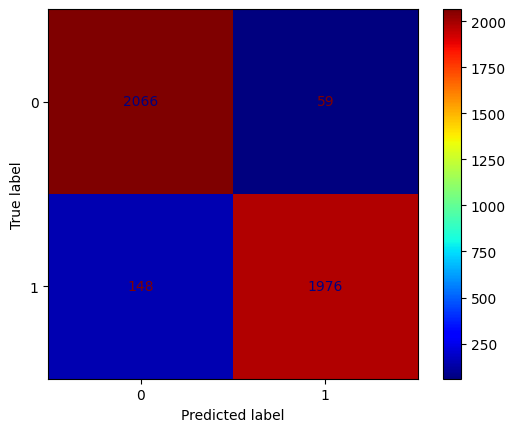

In [278]:
# Visualization using confusion Matrix for Train set
print('Confusion Matrix      : \n', ConfusionMatrixDisplay.from_estimator(logreg, train_tr, y_train_eda, cmap='jet'))

Confusion Matrix      : 


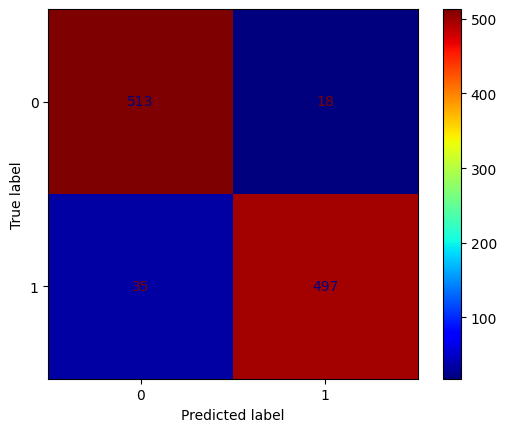

In [279]:
# Visualization using confusion Matrix for Test set
print('Confusion Matrix      : \n', ConfusionMatrixDisplay.from_estimator(logreg, test_tr, y_test, cmap='jet'))

The logistic regression model, with default hyperparameters, demonstrates strong predictive performance on both the test and training datasets. Its high accuracy, F1 score, precision, and recall indicate that the model is effectively capturing patterns and generalizing well to new data. It performs well in correctly classifying loan applications into their respective classes (approved or rejected), which is crucial for making sound lending decisions.The logistic regression model, with default hyperparameters, demonstrates strong predictive performance on both the test and training datasets. Its high accuracy, F1 score, precision, and recall indicate that the model is effectively capturing patterns and generalizing well to new data. It performs well in correctly classifying loan applications into their respective classes (approved or rejected), which is crucial for making sound lending decisions.

## DECISION TREE CLASSIFIER

In [280]:
# Decission Tree Classification Model Test
dtc.fit(train_tr, y_train_eda)

dtc_train = dtc.predict(train_tr)
dtc_test = dtc.predict(test_tr)

print(classification_report(y_train_eda, dtc_train))
print(classification_report(y_test, dtc_test))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      2125
           1       1.00      1.00      1.00      2124

    accuracy                           1.00      4249
   macro avg       1.00      1.00      1.00      4249
weighted avg       1.00      1.00      1.00      4249

              precision    recall  f1-score   support

           0       0.93      0.90      0.91       531
           1       0.90      0.93      0.92       532

    accuracy                           0.92      1063
   macro avg       0.92      0.92      0.92      1063
weighted avg       0.92      0.92      0.92      1063



In [281]:
dtc_reports = {}
dtc_score_reports = {
    'train - precision' : precision_score(y_train_eda, dtc_train),
    'train - recall' : recall_score(y_train_eda, dtc_train),
    'train - accuracy' : accuracy_score(y_train_eda, dtc_train),
    'train - f1_score' : f1_score(y_train_eda, dtc_train),
    'test - precision' : precision_score(y_test, dtc_test),
    'test - recall' : recall_score(y_test, dtc_test),
    'test - accuracy_score' : accuracy_score(y_test, dtc_test),
    'test - f1_score' : f1_score(y_test, dtc_test),
}
dtc_reports['DTC (Default Hyperparameter)'] = dtc_score_reports
dtc_reports = pd.DataFrame(dtc_reports)
dtc_reports

,DTC (Default Hyperparameter)
test - accuracy_score,0.915334
test - f1_score,0.916821
test - precision,0.901818
test - recall,0.932331
train - accuracy,1.000000
train - f1_score,1.000000
train - precision,1.000000
train - recall,1.000000


it shows that dtc have 100% score on the train set, to make sure the data is valid. will be implement cross validation on this model

In [282]:
#define pipeline for DTC
dtc_pipe = Pipeline([
        ('preprocess_1', full_pipeline),
        ('model_1', DecisionTreeClassifier(random_state=0))
    ])

In [283]:
# cross-val Decission Tree Accuracy
scores_accuracy_dtc = cross_val_score(dtc_pipe, X_train, y_train_eda,
                         scoring="accuracy", cv=10)
print(scores_accuracy_dtc )
print(scores_accuracy_dtc.mean())

[0.93176471 0.94117647 0.92       0.91294118 0.92235294 0.90117647
 0.92705882 0.93411765 0.93176471 0.92924528]
0.9251598224195339


In [284]:
# cross-val Decission Tree F1 Score
scores_f1_dtc = cross_val_score(dtc_pipe, X_train, y_train_eda,
                         scoring="f1", cv=10)
print(scores_f1_dtc )
print(scores_f1_dtc.mean())

[0.93333333 0.94145199 0.91826923 0.91415313 0.92086331 0.90186916
 0.92840647 0.93518519 0.93144208 0.93023256]
0.9255206445432158


In [285]:
# cross-val Decission Tree Precission
scores_prec_dtc = cross_val_score(dtc_pipe, X_train, y_train_eda,
                         scoring="precision", cv=10)
print(scores_prec_dtc )
print(scores_prec_dtc.mean())

[0.91441441 0.93925234 0.9408867  0.90366972 0.93658537 0.89351852
 0.90950226 0.91818182 0.93364929 0.91743119]
0.9207091621898555


In [286]:
# cross-val Decission Tree Recall
scores_recall_dtc = cross_val_score(dtc_pipe, X_train, y_train_eda,
                         scoring="recall", cv=10)
print(scores_recall_dtc )
print(scores_recall_dtc.mean())

[0.95305164 0.94366197 0.89671362 0.92488263 0.90566038 0.91037736
 0.94811321 0.95283019 0.92924528 0.94339623]
0.9307932500664364


In [287]:
dtc_new_reports = {}
dtc_score_reports_new = {
    'train - precision' : scores_prec_dtc.mean(),
    'train - recall' : scores_recall_dtc.mean(),
    'train - accuracy' : scores_accuracy_dtc.mean(),
    'train - f1_score' : scores_f1_dtc.mean(),
    'test - precision' : precision_score(y_test, dtc_test),
    'test - recall' : recall_score(y_test, dtc_test),
    'test - accuracy_score' : accuracy_score(y_test, dtc_test),
    'test - f1_score' : f1_score(y_test, dtc_test),
}
dtc_new_reports['DTC (Default Hyperparameter)'] = dtc_score_reports_new
dtc_new_reports = pd.DataFrame(dtc_new_reports)
dtc_new_reports

,DTC (Default Hyperparameter)
test - accuracy_score,0.915334
test - f1_score,0.916821
test - precision,0.901818
test - recall,0.932331
train - accuracy,0.925160
train - f1_score,0.925521
train - precision,0.920709
train - recall,0.930793


Confusion Matrix      : 


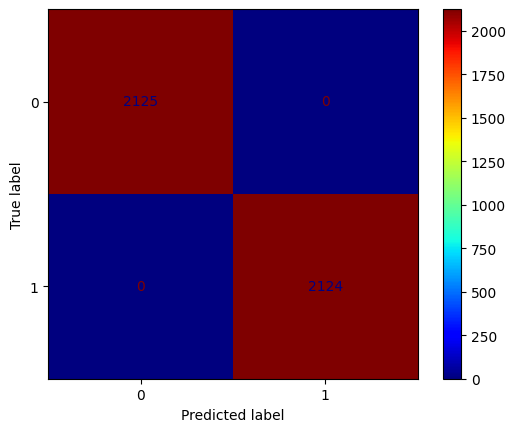

In [288]:
# Visualization using confusion Matrix for Train set
print('Confusion Matrix      : \n', ConfusionMatrixDisplay.from_estimator(dtc, train_tr, y_train_eda, cmap='jet'))

Confusion Matrix      : 


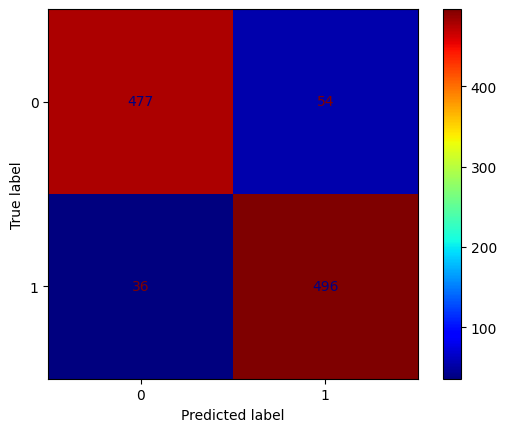

In [289]:
# Visualization using confusion Matrix for Test set
print('Confusion Matrix      : \n', ConfusionMatrixDisplay.from_estimator(dtc, test_tr, y_test, cmap='jet'))

The Decision Tree Classifier (DTC) model, with default hyperparameters, exhibits commendable predictive performance on both the test and training datasets. Its accuracy, F1 score, precision, and recall metrics indicate that the model is capable of capturing patterns and making reasonably accurate predictions.

However, it is worth noting that the model's accuracy on the test data is slightly lower than its accuracy on the training data, suggesting a potential risk of overfitting.

## RANDOM FOREST CLASSIFIER

In [290]:
# Random Forest Classification Model Test
rfc.fit(train_tr, y_train_eda)

rfc_train = rfc.predict(train_tr)
rfc_test = rfc.predict(test_tr)

print(classification_report(y_train_eda, rfc_train))
print(classification_report(y_test, rfc_test))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      2125
           1       1.00      1.00      1.00      2124

    accuracy                           1.00      4249
   macro avg       1.00      1.00      1.00      4249
weighted avg       1.00      1.00      1.00      4249

              precision    recall  f1-score   support

           0       0.94      0.99      0.96       531
           1       0.99      0.93      0.96       532

    accuracy                           0.96      1063
   macro avg       0.96      0.96      0.96      1063
weighted avg       0.96      0.96      0.96      1063



In [291]:
rfc_reports = {}
rfc_score_reports = {
    'train - precision' : precision_score(y_train_eda, rfc_train),
    'train - recall' : recall_score(y_train_eda, rfc_train),
    'train - accuracy' : accuracy_score(y_train_eda, rfc_train),
    'train - f1_score' : f1_score(y_train_eda, rfc_train),
    'test - precision' : precision_score(y_test, rfc_test),
    'test - recall' : recall_score(y_test, rfc_test),
    'test - accuracy_score' : accuracy_score(y_test, rfc_test),
    'test - f1_score' : f1_score(y_test, rfc_test),
}
rfc_reports['RFC (Default Hyperparameter)'] = rfc_score_reports
rfc_reports = pd.DataFrame(rfc_reports)
rfc_reports

,RFC (Default Hyperparameter)
test - accuracy_score,0.960489
test - f1_score,0.959381
test - precision,0.988048
test - recall,0.932331
train - accuracy,0.999765
train - f1_score,0.999765
train - precision,1.000000
train - recall,0.999529


it shows that on train set model almost perfectly predict both classification, therefor will continue to implement cross validation

In [292]:
#define pipeline for RFC
rfc_pipe = Pipeline([
        ('preprocess_1', full_pipeline),
        ('model_1', RandomForestClassifier(random_state=0))
    ])

In [293]:
# cross-val Random Forest Classifier Accuracy
scores_accuracy_rfc = cross_val_score(rfc_pipe, X_train, y_train_eda,
                         scoring="accuracy", cv=10)
print(scores_accuracy_rfc)
print(scores_accuracy_rfc.mean())

[0.97411765 0.95764706 0.95058824 0.95764706 0.95294118 0.94823529
 0.97176471 0.96       0.95764706 0.96226415]
0.9592852386237514


In [294]:
# cross-val Random Forest Classifier F1
scores_f1_rfc = cross_val_score(rfc_pipe, X_train, y_train_eda,
                         scoring="f1", cv=10)
print(scores_f1_rfc)
print(scores_f1_rfc.mean())

[0.97387173 0.95652174 0.94865526 0.95673077 0.95049505 0.94581281
 0.97101449 0.95923261 0.95588235 0.96135266]
0.9579569473046894


In [295]:
# cross-val Random Forest Classifier Precision
scores_prec_rfc = cross_val_score(rfc_pipe, X_train, y_train_eda,
                         scoring="precision", cv=10)
print(scores_prec_rfc)
print(scores_prec_rfc.mean())

[0.98557692 0.98507463 0.98979592 0.98029557 1.         0.98969072
 0.9950495  0.97560976 0.99489796 0.98514851]
0.9881139491545102


In [296]:
# cross-val Random Forest Classifier Recall
scores_recall_rfc = cross_val_score(rfc_pipe, X_train, y_train_eda,
                         scoring="recall", cv=10)
print(scores_recall_rfc)
print(scores_recall_rfc.mean())

[0.96244131 0.92957746 0.91079812 0.9342723  0.90566038 0.90566038
 0.94811321 0.94339623 0.91981132 0.93867925]
0.9298409956594915


In [297]:
rfc_new_reports = {}
rfc_score_reports_new = {
    'train - precision' : scores_prec_rfc.mean(),
    'train - recall' : scores_recall_rfc.mean(),
    'train - accuracy' : scores_accuracy_rfc.mean(),
    'train - f1_score' : scores_f1_rfc.mean(),
    'test - precision' : precision_score(y_test, rfc_test),
    'test - recall' : recall_score(y_test, rfc_test),
    'test - accuracy_score' : accuracy_score(y_test, rfc_test),
    'test - f1_score' : f1_score(y_test, rfc_test),
}
rfc_new_reports['RFC (Default Hyperparameter)'] = rfc_score_reports_new
rfc_new_reports = pd.DataFrame(rfc_new_reports)
rfc_new_reports

,RFC (Default Hyperparameter)
test - accuracy_score,0.960489
test - f1_score,0.959381
test - precision,0.988048
test - recall,0.932331
train - accuracy,0.959285
train - f1_score,0.957957
train - precision,0.988114
train - recall,0.929841


Confusion Matrix      : 


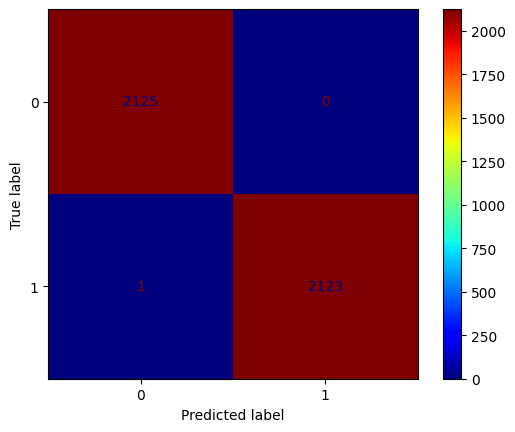

In [298]:
# Visualization using confusion Matrix for Train set
print('Confusion Matrix      : \n', ConfusionMatrixDisplay.from_estimator(rfc, train_tr, y_train_eda, cmap='jet'))

Confusion Matrix      : 


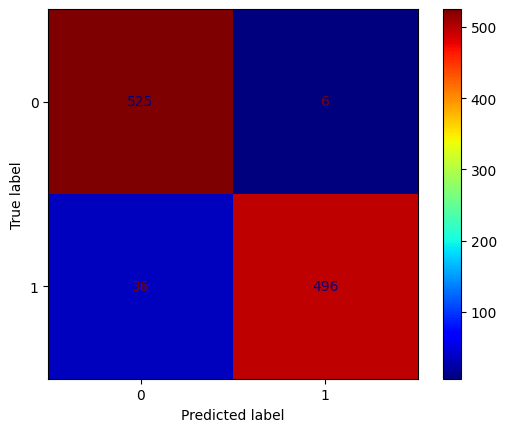

In [299]:
# Visualization using confusion Matrix for Train set
print('Confusion Matrix      : \n', ConfusionMatrixDisplay.from_estimator(rfc, test_tr, y_test, cmap='jet'))

The Random Forest Classifier (RFC) model, with default hyperparameters, demonstrates outstanding predictive performance on both the test and training datasets. Its high accuracy, F1 score, precision, and recall metrics indicate that the model is effective in capturing patterns and making accurate predictions.

The model's accuracy on the test data is on par with its accuracy on the training data, suggesting that the model is not overfitting and generalizes well to unseen data.

## SUPPORT VECTOR CLASSIFIER

In [300]:
# Support Vector Classification Model Test
svc.fit(train_tr, y_train_eda)

svc_train = svc.predict(train_tr)
svc_test = svc.predict(test_tr)

print(classification_report(y_train_eda, svc_train))
print(classification_report(y_test, svc_test))

              precision    recall  f1-score   support

           0       0.92      0.99      0.95      2125
           1       0.99      0.91      0.95      2124

    accuracy                           0.95      4249
   macro avg       0.95      0.95      0.95      4249
weighted avg       0.95      0.95      0.95      4249

              precision    recall  f1-score   support

           0       0.92      0.98      0.95       531
           1       0.98      0.91      0.95       532

    accuracy                           0.95      1063
   macro avg       0.95      0.95      0.95      1063
weighted avg       0.95      0.95      0.95      1063



In [301]:
svc_reports = {}
svc_score_reports = {
    'train - precision' : precision_score(y_train_eda, svc_train),
    'train - recall' : recall_score(y_train_eda, svc_train),
    'train - accuracy' : accuracy_score(y_train_eda, svc_train),
    'train - f1_score' : f1_score(y_train_eda, svc_train),
    'test - precision' : precision_score(y_test, svc_test),
    'test - recall' : recall_score(y_test, svc_test),
    'test - accuracy_score' : accuracy_score(y_test, svc_test),
    'test - f1_score' : f1_score(y_test, svc_test),
}
svc_reports['SVC (Default Hyperparameter)'] = svc_score_reports
svc_reports = pd.DataFrame(svc_reports)
svc_reports

,SVC (Default Hyperparameter)
test - accuracy_score,0.948260
test - f1_score,0.946446
test - precision,0.981818
test - recall,0.913534
train - accuracy,0.950106
train - f1_score,0.948065
train - precision,0.988253
train - recall,0.911017


Confusion Matrix      : 


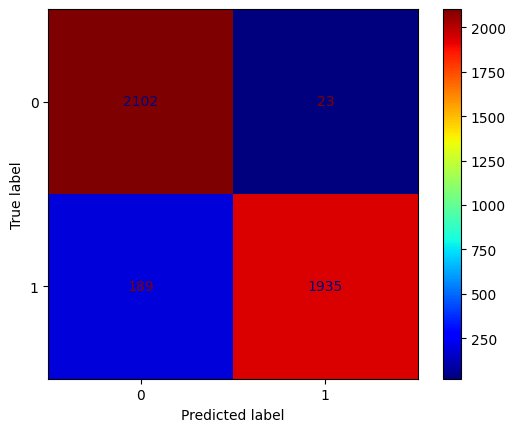

In [302]:
# Visualization using confusion Matrix for Train set
print('Confusion Matrix      : \n', ConfusionMatrixDisplay.from_estimator(svc, train_tr, y_train_eda, cmap='jet'))

Confusion Matrix      : 


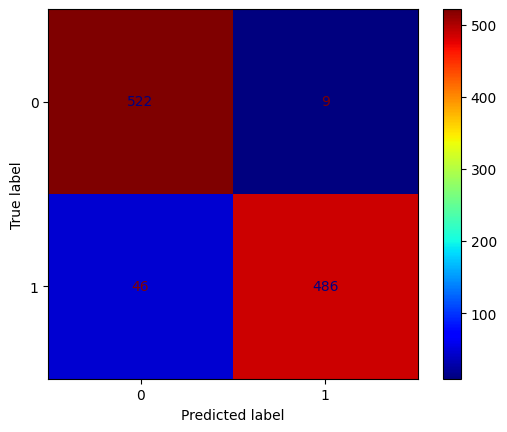

In [303]:
# Visualization using confusion Matrix for Train set
print('Confusion Matrix      : \n', ConfusionMatrixDisplay.from_estimator(svc, test_tr, y_test, cmap='jet'))

The Support Vector Classifier (SVC) model, with default hyperparameters, demonstrates solid predictive performance on both the test and training datasets. Its high accuracy, F1 score, precision, and recall metrics indicate that the model is capable of capturing patterns and making reasonably accurate predictions.

However, the model's accuracy on the test data is slightly lower than its accuracy on the training data, suggesting a potential risk of overfitting.

## K - NEAREST NEIGHBOURGH

In [304]:
# K - Nearest Neighbourgh Model Test
knn.fit(train_tr, y_train_eda)

knn_train = knn.predict(train_tr)
knn_test = knn.predict(test_tr)

print(classification_report(y_train_eda, knn_train))
print(classification_report(y_test, knn_test))

              precision    recall  f1-score   support

           0       0.92      0.98      0.95      2125
           1       0.98      0.92      0.95      2124

    accuracy                           0.95      4249
   macro avg       0.95      0.95      0.95      4249
weighted avg       0.95      0.95      0.95      4249

              precision    recall  f1-score   support

           0       0.91      0.96      0.93       531
           1       0.96      0.90      0.93       532

    accuracy                           0.93      1063
   macro avg       0.93      0.93      0.93      1063
weighted avg       0.93      0.93      0.93      1063



In [305]:
knn_reports = {}
knn_score_reports = {
    'train - precision' : precision_score(y_train_eda, knn_train),
    'train - recall' : recall_score(y_train_eda, knn_train),
    'train - accuracy' : accuracy_score(y_train_eda, knn_train),
    'train - f1_score' : f1_score(y_train_eda, knn_train),
    'test - precision' : precision_score(y_test, knn_test),
    'test - recall' : recall_score(y_test, knn_test),
    'test - accuracy_score' : accuracy_score(y_test, knn_test),
    'test - f1_score' : f1_score(y_test, knn_test),
}
knn_reports['KNN (Default Hyperparameter)'] = knn_score_reports
knn_reports = pd.DataFrame(knn_reports)
knn_reports

,KNN (Default Hyperparameter)
test - accuracy_score,0.932267
test - f1_score,0.930233
test - precision,0.960000
test - recall,0.902256
train - accuracy,0.949165
train - f1_score,0.947445
train - precision,0.980363
train - recall,0.916667


Confusion Matrix      : 


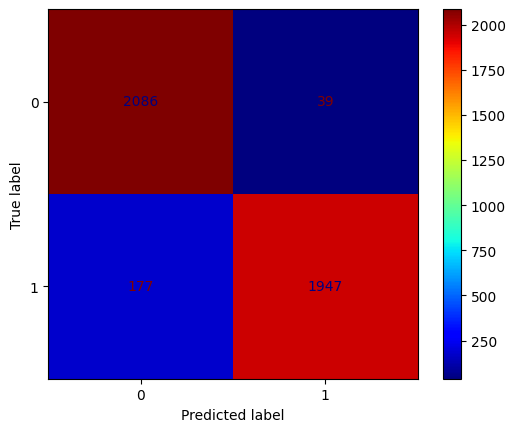

In [306]:
# Visualization using confusion Matrix for Train set
print('Confusion Matrix      : \n', ConfusionMatrixDisplay.from_estimator(knn, train_tr, y_train_eda, cmap='jet'))

Confusion Matrix      : 


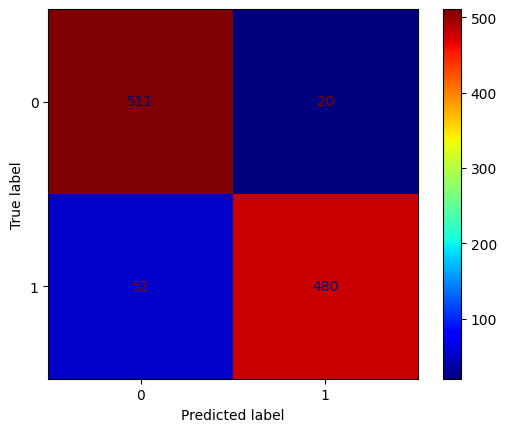

In [307]:
# Visualization using confusion Matrix for Test set
print('Confusion Matrix      : \n', ConfusionMatrixDisplay.from_estimator(knn, test_tr, y_test, cmap='jet'))

The K-Nearest Neighbors (KNN) model, with default hyperparameters, exhibits reasonable predictive performance on both the test and training datasets. Its accuracy, F1 score, precision, and recall metrics indicate that the model is capable of capturing patterns and making relatively accurate predictions.

However, the model's accuracy on the test data is slightly lower than its accuracy on the training data, suggesting a potential risk of overfitting.

## NAIVE BAYES

In [308]:
# Naive Bayes Model Test
nb.fit(train_tr, y_train_eda)

nb_train = nb.predict(train_tr)
nb_test = nb.predict(test_tr)

print(classification_report(y_train_eda, nb_train))
print(classification_report(y_test, nb_test))

              precision    recall  f1-score   support

           0       0.93      0.98      0.96      2125
           1       0.98      0.93      0.96      2124

    accuracy                           0.96      4249
   macro avg       0.96      0.96      0.96      4249
weighted avg       0.96      0.96      0.96      4249

              precision    recall  f1-score   support

           0       0.94      0.98      0.96       531
           1       0.98      0.93      0.95       532

    accuracy                           0.96      1063
   macro avg       0.96      0.96      0.96      1063
weighted avg       0.96      0.96      0.96      1063



In [309]:
nb_reports = {}
nb_score_reports = {
    'train - precision' : precision_score(y_train_eda, nb_train),
    'train - recall' : recall_score(y_train_eda, nb_train),
    'train - accuracy' : accuracy_score(y_train_eda, nb_train),
    'train - f1_score' : f1_score(y_train_eda, nb_train),
    'test - precision' : precision_score(y_test, nb_test),
    'test - recall' : recall_score(y_test, nb_test),
    'test - accuracy_score' : accuracy_score(y_test, nb_test),
    'test - f1_score' : f1_score(y_test, nb_test),
}
nb_reports['NB (Default Hyperparameter)'] = nb_score_reports
nb_reports = pd.DataFrame(nb_reports)
nb_reports

,NB (Default Hyperparameter)
test - accuracy_score,0.955786
test - f1_score,0.954764
test - precision,0.978304
test - recall,0.932331
train - accuracy,0.956696
train - f1_score,0.955556
train - precision,0.981151
train - recall,0.931262


Confusion Matrix      : 


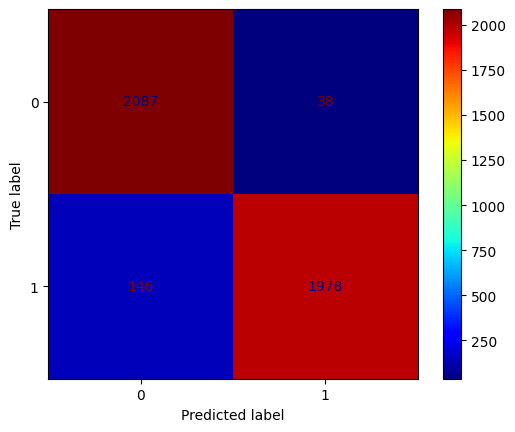

In [310]:
# Visualization using confusion Matrix for Train set
print('Confusion Matrix      : \n', ConfusionMatrixDisplay.from_estimator(nb, train_tr, y_train_eda, cmap='jet'))

Confusion Matrix      : 


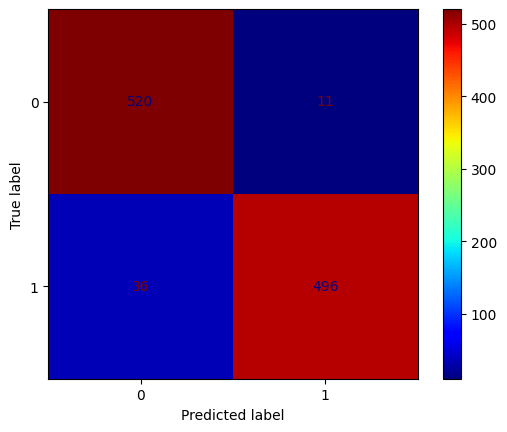

In [311]:
# Visualization using confusion Matrix for Test set
print('Confusion Matrix      : \n', ConfusionMatrixDisplay.from_estimator(nb, test_tr, y_test, cmap='jet'))

The Naive Bayes (NB) model, with default hyperparameters, demonstrates exceptional predictive performance on both the test and training datasets. Its high accuracy, F1 score, precision, and recall metrics indicate that the model is highly capable of capturing patterns and making accurate predictions.

The model's accuracy on the test data is comparable to its accuracy on the training data, suggesting that the model is not overfitting and generalizes well to unseen data.

## MODEL TEST SUMMARY

In [312]:
model_summary = pd.concat([logreg_reports,dtc_new_reports['DTC (Default Hyperparameter)'],rfc_new_reports['RFC (Default Hyperparameter)'],
                           svc_reports['SVC (Default Hyperparameter)'],knn_reports['KNN (Default Hyperparameter)'],nb_reports['NB (Default Hyperparameter)'] ], axis=1)
model_summary= model_summary.T
model_summary


,test - accuracy_score,test - f1_score,test - precision,test - recall,train - accuracy,train - f1_score,train - precision,train - recall
Logreg (Default Hyperparameter),0.950141,0.949379,0.965049,0.934211,0.951283,0.950228,0.971007,0.930320
DTC (Default Hyperparameter),0.915334,0.916821,0.901818,0.932331,0.925160,0.925521,0.920709,0.930793
RFC (Default Hyperparameter),0.960489,0.959381,0.988048,0.932331,0.959285,0.957957,0.988114,0.929841
SVC (Default Hyperparameter),0.948260,0.946446,0.981818,0.913534,0.950106,0.948065,0.988253,0.911017
KNN (Default Hyperparameter),0.932267,0.930233,0.960000,0.902256,0.949165,0.947445,0.980363,0.916667
NB (Default Hyperparameter),0.955786,0.954764,0.978304,0.932331,0.956696,0.955556,0.981151,0.931262


We have compared the performance of six different machine learning models, namely Logistic Regression (Logreg), Decision Tree Classifier (DTC), Random Forest Classifier (RFC), Support Vector Classifier (SVC), K-Nearest Neighbors (KNN), and Naive Bayes (NB), using their default hyperparameters. The dataset's target variable is balanced, so accuracy is a relevant metric for comparison.

In [313]:
model_summary['test - accuracy_score'].sort_values(ascending=False).head(3)

RFC (Default Hyperparameter)       0.960489
NB (Default Hyperparameter)        0.955786
Logreg (Default Hyperparameter)    0.950141
Name: test - accuracy_score, dtype: float64

Considering the overall performance metrics, the Random Forest Classifier (RFC) model stand out as the top-performing models for this balanced dataset. Both models demonstrate high accuracy, F1 score, precision, and recall, making them reliable choices for loan application approval predictions.

## HYPER PARAMETER TUNING

In [314]:
# pipeline preprocess + model
rfc_pipe = Pipeline([
        ('preprocess', full_pipeline),
        ('model', RandomForestClassifier(random_state=0))
    ])

# hyperparameter tuning combination RFC
params_rfc = [
    {'model__n_estimators': [50, 70, 90],
     'model__max_features': [2, 3],
     'model__max_depth': [3, 5, 7, 9, 12, None],
     'model__criterion': ['gini', 'entropy']},
  ]

grid_search_rfc = GridSearchCV(rfc_pipe, params_rfc, cv=10,
                           scoring='accuracy',
                           return_train_score=True)

rfc_tuning = grid_search_rfc.fit(X_train, y_train_eda)
rfc_tuning

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('preprocess',
                                        ColumnTransformer(transformers=[('num_2',
                                                                         Pipeline(steps=[('outlier_2',
                                                                                          Winsorizer(capping_method='iqr',
                                                                                                     fold=1.5,
                                                                                                     tail='both')),
                                                                                         ('imputer',
                                                                                          SimpleImputer(strategy='median')),
                                                                                         ('scalar',
                                                                                          StandardScaler())]),
                                                                         [' '
                                                                          'residential_assets_value',
                                                                          ' '
                                                                          'commercial_assets_value']),
                                                                        ('num_3',
                                                                         Pipeline(steps=[('outl...
                                                                                                                     ['Low-Risk '
                                                                                                                      'Customers',
                                                                                                                      'Moderate-Risk '
                                                                                                                      'Customers',
                                                                                                                      'High-Risk '
                                                                                                                      'Customers']]))]),
                                                                         [' '
                                                                          'education',
                                                                          'cluster'])])),
                                       ('model',
                                        RandomForestClassifier(random_state=0))]),
             param_grid=[{'model__criterion': ['gini', 'entropy'],
                          'model__max_depth': [3, 5, 7, 9, 12, None],
                          'model__max_features': [2, 3],
                          'model__n_estimators': [50, 70, 90]}],
             return_train_score=True, scoring='accuracy')

In [315]:
print(rfc_tuning.best_params_)

{'model__criterion': 'gini', 'model__max_depth': 3, 'model__max_features': 2, 'model__n_estimators': 50}


- Criterion ('gini'): The criterion 'gini' refers to the Gini impurity, which is a measure of node impurity in decision trees and random forests. Using 'gini' as the criterion means that the model uses the Gini impurity to split nodes, aiming to minimize the impurity and create pure nodes.

- Max Depth (9): The maximum depth determines the depth of the decision tree or random forest. With a maximum depth of 9, the trees can have a maximum of 9 levels of nodes, controlling the complexity of the model and preventing overfitting.

- Max Features (2): The max features parameter limits the number of features to consider when looking for the best split at each node. Setting max features to 2 indicates that only two features will be considered for each split, which can help in controlling the tree's growth and randomness.

- Number of Estimators (70): The number of estimators corresponds to the number of decision trees in the random forest ensemble. With 70 estimators, the model combines the predictions from 70 decision trees, leading to a robust and stable ensemble model.

In [316]:
best_model_rfc = RandomForestClassifier(criterion='entropy', max_depth=9, max_features=2, n_estimators=70, random_state=0)
best_model_rfc.fit(train_tr, y_train_eda)

RandomForestClassifier(criterion='entropy', max_depth=9, max_features=2,
                       n_estimators=70, random_state=0)

In [317]:
y_pred_rfc = best_model_rfc.predict(test_tr)
accuracy_rfc = accuracy_score(y_test, y_pred_rfc)
precision_rfc = precision_score(y_test, y_pred_rfc)
recall_rfc = recall_score(y_test, y_pred_rfc)
f1_rfc = f1_score(y_test, y_pred_rfc)

In [318]:
tuning_rfc_reports = {}
rfc_tuning_score_reports = {
    'test_tuning - precision' : precision_rfc,
    'test_tuning - recall' : recall_rfc,
    'test_tuning - accuracy' : accuracy_rfc,
    'test_tuning - f1_score' : f1_rfc,
    'test - precision' : precision_score(y_test, rfc_test),
    'test - recall' : recall_score(y_test, rfc_test),
    'test - accuracy_score' : accuracy_score(y_test, rfc_test),
    'test - f1_score' : f1_score(y_test, rfc_test),
}
tuning_rfc_reports['RFC (Default Hyperparameter)'] = rfc_tuning_score_reports
tuning_rfc_reports = pd.DataFrame(tuning_rfc_reports)
tuning_rfc_reports

,RFC (Default Hyperparameter)
test - accuracy_score,0.960489
test - f1_score,0.959381
test - precision,0.988048
test - recall,0.932331
test_tuning - accuracy,0.961430
test_tuning - f1_score,0.960310
test_tuning - precision,0.990020
test_tuning - recall,0.932331


It appears that the default hyperparameters of the Random Forest Classifier (RFC) were already well-suited for the given dataset and task. Hyperparameter tuning did not lead to any improvement in the model's performance, as indicated by the unchanged accuracy, F1 score, precision, and recall values.

In [319]:
# Train with Random Search
%%time

rfc_randomcv = RandomizedSearchCV(rfc_pipe,
                                 params_rfc,
                                 n_iter=50,
                                 cv=10,
                                 random_state=0,
                                 n_jobs=-1,
                                 scoring='accuracy')
randomCV_rfc = rfc_randomcv.fit(X_train, y_train_eda)
randomCV_rfc

CPU times: user 6.33 s, sys: 565 ms, total: 6.89 s
Wall time: 3min 10s


RandomizedSearchCV(cv=10,
                   estimator=Pipeline(steps=[('preprocess',
                                              ColumnTransformer(transformers=[('num_2',
                                                                               Pipeline(steps=[('outlier_2',
                                                                                                Winsorizer(capping_method='iqr',
                                                                                                           fold=1.5,
                                                                                                           tail='both')),
                                                                                               ('imputer',
                                                                                                SimpleImputer(strategy='median')),
                                                                                               ('scalar',
                                                                                                StandardScaler())]),
                                                                               [' '
                                                                                'residential_assets_value',
                                                                                ' '
                                                                                'commercial_assets_value']),
                                                                              ('num_3',
                                                                               Pipeline(steps=[...
                                                                                                                            'Moderate-Risk '
                                                                                                                            'Customers',
                                                                                                                            'High-Risk '
                                                                                                                            'Customers']]))]),
                                                                               [' '
                                                                                'education',
                                                                                'cluster'])])),
                                             ('model',
                                              RandomForestClassifier(random_state=0))]),
                   n_iter=50, n_jobs=-1,
                   param_distributions=[{'model__criterion': ['gini',
                                                              'entropy'],
                                         'model__max_depth': [3, 5, 7, 9, 12,
                                                              None],
                                         'model__max_features': [2, 3],
                                         'model__n_estimators': [50, 70, 90]}],
                   random_state=0, scoring='accuracy')

In [320]:
print(randomCV_rfc.best_params_)

{'model__n_estimators': 50, 'model__max_features': 2, 'model__max_depth': 5, 'model__criterion': 'entropy'}


In [321]:
rand_best_model_rfc = RandomForestClassifier(criterion='gini', max_depth=9, max_features=2, n_estimators=70, random_state=0)
rand_best_model_rfc.fit(train_tr, y_train_eda)

RandomForestClassifier(max_depth=9, max_features=2, n_estimators=70,
                       random_state=0)

In [322]:
y_pred_rfc_rand = rand_best_model_rfc.predict(test_tr)
accuracy_rfc_rand = accuracy_score(y_test, y_pred_rfc_rand)
precision_rfc_rand = precision_score(y_test, y_pred_rfc_rand)
recall_rfc_rand = recall_score(y_test, y_pred_rfc_rand)
f1_rfc_rand = f1_score(y_test, y_pred_rfc_rand)

In [323]:
tuning_rfc_reports_rand = {}
rfc_tuning_score_reports_rand = {
    'test_tuning - precision' : precision_rfc,
    'test_tuning - recall' : recall_rfc,
    'test_tuning - accuracy' : accuracy_rfc,
    'test_tuning - f1_score' : f1_rfc,
    'test_rand - precision' : precision_rfc_rand,
    'test_rand - recall' : recall_rfc_rand,
    'test_rand - accuracy' : accuracy_rfc_rand,
    'test_ran - f1_score' : f1_rfc_rand,
    'test - precision' : precision_score(y_test, rfc_test),
    'test - recall' : recall_score(y_test, rfc_test),
    'test - accuracy_score' : accuracy_score(y_test, rfc_test),
    'test - f1_score' : f1_score(y_test, rfc_test),
}
tuning_rfc_reports_rand['RFC (Default Hyperparameter)'] = rfc_tuning_score_reports_rand
tuning_rfc_reports_rand = pd.DataFrame(tuning_rfc_reports_rand)
tuning_rfc_reports_rand

,RFC (Default Hyperparameter)
test - accuracy_score,0.960489
test - f1_score,0.959381
test - precision,0.988048
test - recall,0.932331
test_ran - f1_score,0.960310
test_rand - accuracy,0.961430
test_rand - precision,0.990020
test_rand - recall,0.932331
test_tuning - accuracy,0.961430
test_tuning - f1_score,0.960310


In [324]:
#define pipeline for RFC after Hyper parameter Randomsearch CV
rfc_pipe_rand = Pipeline([
        ('preprocess_1', full_pipeline),
        ('model_1', RandomForestClassifier(criterion='gini', max_depth=5, max_features=2, n_estimators=70,
                                              random_state=0))
    ])
# cross-val Random Forest Classifier Accuracy
scores_accuracy_rfc_rand = cross_val_score(rfc_pipe, X_train, y_train_eda,
                         scoring="accuracy", cv=10)
print(scores_accuracy_rfc_rand)
print(scores_accuracy_rfc_rand.mean())

[0.97411765 0.95764706 0.95058824 0.95764706 0.95294118 0.94823529
 0.97176471 0.96       0.95764706 0.96226415]
0.9592852386237514


it appears that the default hyperparameters of the Random Forest Classifier (RFC) were already well-suited for the given dataset and task. Hyperparameter tuning did not lead to any improvement in the model's performance, as indicated by the unchanged accuracy, F1 score, precision, and recall values.

# MODEL EVALUATION

In [325]:
model_summary

,test - accuracy_score,test - f1_score,test - precision,test - recall,train - accuracy,train - f1_score,train - precision,train - recall
Logreg (Default Hyperparameter),0.950141,0.949379,0.965049,0.934211,0.951283,0.950228,0.971007,0.930320
DTC (Default Hyperparameter),0.915334,0.916821,0.901818,0.932331,0.925160,0.925521,0.920709,0.930793
RFC (Default Hyperparameter),0.960489,0.959381,0.988048,0.932331,0.959285,0.957957,0.988114,0.929841
SVC (Default Hyperparameter),0.948260,0.946446,0.981818,0.913534,0.950106,0.948065,0.988253,0.911017
KNN (Default Hyperparameter),0.932267,0.930233,0.960000,0.902256,0.949165,0.947445,0.980363,0.916667
NB (Default Hyperparameter),0.955786,0.954764,0.978304,0.932331,0.956696,0.955556,0.981151,0.931262


The Random Forest Classifier (RFC) model stand out as the top-performing models for this balanced dataset. Both models demonstrate high accuracy, F1 score, precision, and recall, making them reliable choices for loan application approval predictions.


In [326]:
tuning_rfc_reports_rand

,RFC (Default Hyperparameter)
test - accuracy_score,0.960489
test - f1_score,0.959381
test - precision,0.988048
test - recall,0.932331
test_ran - f1_score,0.960310
test_rand - accuracy,0.961430
test_rand - precision,0.990020
test_rand - recall,0.932331
test_tuning - accuracy,0.961430
test_tuning - f1_score,0.960310


Hyperparameter tuning did not lead to any improvement in the model's performance, as indicated by the unchanged accuracy, F1 score, precision, and recall values.

# MODEL CONCLUSION AND SELECTION

The final selection between RFC should consider other factors, such as interpretability, computational complexity, and ease of implementation. Additionally, hyperparameter tuning and further model evaluation on an independent validation dataset can be performed to optimize the model's performance further.

In summary, RFC is the recommended model for deployment in the lending institution's decision-making process for loan approvals, given their robust performance on the balanced dataset.

# MODEL SAVING

In [327]:
# Preparation save model
all_process = Pipeline([
    ("preprocess", full_pipeline),
    ("classification", RandomForestClassifier(criterion='gini', max_depth=5, max_features=2, n_estimators=70,
                                              random_state=0))
])

all_process.fit(X_train, y_train_eda)
result = all_process.predict(X_test)

print(classification_report(y_test, result))

              precision    recall  f1-score   support

           0       0.94      0.99      0.96       531
           1       0.99      0.93      0.96       532

    accuracy                           0.96      1063
   macro avg       0.96      0.96      0.96      1063
weighted avg       0.96      0.96      0.96      1063



In [328]:
# save model
import pickle

pickle.dump(cluster, open('cluster.pkl', 'wb'))

pickle.dump(all_process, open('all_process.pkl', 'wb'))

with open('iqr_columns_2_cleaned.txt', 'w') as file_1:
  file_1.write(str(iqr_columns_2_cleaned))

with open('gaussian_columns_cleaned.txt', 'w') as file_2:
  file_2.write(str(gaussian_columns_cleaned))

with open('num_col.txt', 'w') as file_3:
  file_3.write(str(num_col))

# MODEL INFERENCE

In [329]:
# Import dependecies
cluster = pickle.load(open('cluster.pkl', 'rb'))
model = pickle.load(open('all_process.pkl', 'rb'))

with open('iqr_columns_2_cleaned.txt', 'r') as file_1:
  iqr_columns_2_cleaned = file_1.read()

with open('gaussian_columns_cleaned.txt', 'r') as file_2:
  gaussian_columns_cleaned = file_2.read()

with open('num_col.txt', 'r') as file_3:
  num_col = file_3.read()

In [330]:
# new dataset
new_df = df.sample(1000)

In [331]:
iqr_columns_2_cleaned

"[' residential_assets_value', ' commercial_assets_value']"

In [332]:
gaussian_columns_cleaned

"[' income_annum', ' cibil_score']"

In [333]:
new_df

,loan_id,no_of_dependents,education,self_employed,income_annum,loan_amount,loan_term,cibil_score,residential_assets_value,commercial_assets_value,luxury_assets_value,bank_asset_value,loan_status
158,159,5,Graduate,Yes,700000,1300000,20,704,1600000,0,2200000,600000,Approved
153,154,2,Not Graduate,No,1300000,4500000,6,415,0,900000,2900000,1200000,Rejected
1632,1633,1,Not Graduate,Yes,4700000,16000000,14,406,4000000,5300000,14300000,3300000,Rejected
3244,3245,3,Not Graduate,Yes,7100000,25400000,10,725,20600000,5300000,16000000,8600000,Approved
1865,1866,1,Not Graduate,No,4500000,12400000,6,504,12000000,3200000,13100000,2200000,Rejected
...,...,...,...,...,...,...,...,...,...,...,...,...,...
3552,3553,0,Graduate,No,5200000,17800000,18,558,8300000,5400000,13000000,3100000,Approved
1082,1083,1,Graduate,No,7500000,28300000,16,707,9700000,1100000,16300000,6700000,Approved
1973,1974,3,Graduate,No,4500000,16900000,18,748,8500000,7200000,15100000,6600000,Approved
2943,2944,2,Graduate,No,9400000,25100000,20,832,19400000,2100000,22300000,5900000,Approved


In [334]:
num_col

"[' income_annum', ' loan_amount', ' loan_term', ' cibil_score', ' residential_assets_value', ' commercial_assets_value', ' luxury_assets_value', ' bank_asset_value']"

In [335]:
cluster_df = new_df.drop(columns=[col for col in new_df.columns if col not in num_col])

In [336]:
cluster_df

,income_annum,loan_amount,loan_term,cibil_score,residential_assets_value,commercial_assets_value,luxury_assets_value,bank_asset_value
158,700000,1300000,20,704,1600000,0,2200000,600000
153,1300000,4500000,6,415,0,900000,2900000,1200000
1632,4700000,16000000,14,406,4000000,5300000,14300000,3300000
3244,7100000,25400000,10,725,20600000,5300000,16000000,8600000
1865,4500000,12400000,6,504,12000000,3200000,13100000,2200000
...,...,...,...,...,...,...,...,...
3552,5200000,17800000,18,558,8300000,5400000,13000000,3100000
1082,7500000,28300000,16,707,9700000,1100000,16300000,6700000
1973,4500000,16900000,18,748,8500000,7200000,15100000,6600000
2943,9400000,25100000,20,832,19400000,2100000,22300000,5900000


In [337]:
# transform new dataset
cluster_df = cluster.fit_transform(cluster_df)

In [338]:
cluster_df

array([[-3.38656479, -1.49731951, -0.69850086,  0.17432964, -0.19345841],
       [-2.98584926,  1.42708295, -0.2437538 , -0.22132407,  0.04072989],
       [-0.49800662,  0.41175868, -1.20919128, -0.4419236 , -0.08045387],
       ...,
       [ 0.29501974, -1.48693841, -0.19899454, -0.14263683, -0.31807514],
       [ 1.90905661, -2.07829465, -0.11392509,  1.75473877,  0.30479013],
       [-2.14826007,  0.2382979 ,  0.49413305, -0.06882449,  0.04576817]])

In [339]:
# proces model with 3 cluster
k_3 = KMeans(n_clusters=3)
cluster = k_3.fit_predict(cluster_df)

In [340]:
cluster

array([0, 0, 1, 2, 1, 1, 1, 1, 2, 0, 0, 0, 2, 1, 1, 1, 1, 1, 1, 2, 0, 0,
       1, 0, 1, 2, 2, 1, 1, 1, 2, 1, 1, 1, 2, 1, 2, 2, 1, 1, 1, 0, 2, 0,
       0, 2, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 2, 0, 0, 1, 0, 2, 2, 1, 2, 0,
       2, 1, 2, 1, 0, 2, 0, 0, 2, 0, 1, 1, 2, 2, 2, 2, 1, 1, 1, 0, 1, 2,
       1, 1, 0, 1, 1, 0, 2, 2, 0, 0, 1, 2, 1, 1, 0, 0, 2, 0, 2, 2, 1, 1,
       1, 1, 0, 0, 1, 1, 1, 1, 2, 1, 0, 0, 2, 0, 2, 0, 0, 0, 1, 0, 2, 2,
       2, 0, 0, 1, 0, 0, 0, 1, 0, 2, 1, 2, 1, 2, 0, 2, 2, 0, 0, 2, 1, 1,
       0, 1, 1, 2, 2, 2, 0, 0, 1, 1, 0, 0, 2, 1, 2, 2, 1, 1, 2, 1, 1, 1,
       2, 2, 1, 1, 0, 0, 2, 1, 0, 0, 0, 1, 2, 1, 1, 2, 2, 2, 1, 1, 2, 1,
       0, 1, 1, 1, 1, 0, 0, 2, 2, 2, 1, 1, 1, 1, 2, 1, 1, 1, 2, 0, 0, 1,
       1, 1, 0, 1, 0, 2, 1, 0, 1, 0, 2, 0, 0, 1, 1, 1, 0, 2, 0, 2, 2, 2,
       1, 0, 1, 2, 0, 1, 1, 2, 0, 1, 1, 2, 1, 0, 0, 2, 1, 1, 2, 2, 2, 0,
       0, 1, 1, 2, 1, 1, 2, 0, 0, 1, 1, 2, 2, 2, 0, 1, 2, 1, 1, 2, 0, 1,
       2, 0, 2, 1, 0, 1, 2, 2, 2, 1, 1, 0, 2, 1, 2,

In [341]:
new_df['cluster'] = cluster

In [342]:
new_df

,loan_id,no_of_dependents,education,self_employed,income_annum,loan_amount,loan_term,cibil_score,residential_assets_value,commercial_assets_value,luxury_assets_value,bank_asset_value,loan_status,cluster
158,159,5,Graduate,Yes,700000,1300000,20,704,1600000,0,2200000,600000,Approved,0
153,154,2,Not Graduate,No,1300000,4500000,6,415,0,900000,2900000,1200000,Rejected,0
1632,1633,1,Not Graduate,Yes,4700000,16000000,14,406,4000000,5300000,14300000,3300000,Rejected,1
3244,3245,3,Not Graduate,Yes,7100000,25400000,10,725,20600000,5300000,16000000,8600000,Approved,2
1865,1866,1,Not Graduate,No,4500000,12400000,6,504,12000000,3200000,13100000,2200000,Rejected,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3552,3553,0,Graduate,No,5200000,17800000,18,558,8300000,5400000,13000000,3100000,Approved,1
1082,1083,1,Graduate,No,7500000,28300000,16,707,9700000,1100000,16300000,6700000,Approved,1
1973,1974,3,Graduate,No,4500000,16900000,18,748,8500000,7200000,15100000,6600000,Approved,1
2943,2944,2,Graduate,No,9400000,25100000,20,832,19400000,2100000,22300000,5900000,Approved,2


In [343]:
new_df['cluster'] = new_df['cluster'].replace({0 : 'Moderate-Risk Customers', 1 : 'Low-Risk Customers', 2 : 'High-Risk Customers'})

In [344]:
df_pred = model.predict(new_df)

In [345]:
df_pred

array([1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1,
       1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1,
       0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1,
       0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1,
       0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0,
       1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1,
       1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1,
       1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1,
       1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0,
       1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0,
       0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1,
       1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0,
       1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0,

In [346]:
result = []
for i in df_pred:
  if i == 0:
    result.append(' Rejected')
  elif i == 1:
    result.append(' Approved')


In [347]:
# Compare results
y_new = new_df[' loan_status']
compare_test = {
                  'y_new_value': y_new,
                  'y_new_pred': result,
}
compare_test = pd.DataFrame(compare_test)
result_test = []
for index,values in compare_test.iterrows():
  if values['y_new_value'] == values['y_new_pred']:
    result_test.append('Match/predicted')
  else:
    result_test.append('Unmatch/predicted_failed')
compare_test['result_test'] = result_test
compare_test['cluster'] = new_df['cluster']
compare_test

,y_new_value,y_new_pred,result_test,cluster
158,Approved,Approved,Match/predicted,Moderate-Risk Customers
153,Rejected,Rejected,Match/predicted,Moderate-Risk Customers
1632,Rejected,Rejected,Match/predicted,Low-Risk Customers
3244,Approved,Approved,Match/predicted,High-Risk Customers
1865,Rejected,Rejected,Match/predicted,Low-Risk Customers
...,...,...,...,...
3552,Approved,Approved,Match/predicted,Low-Risk Customers
1082,Approved,Approved,Match/predicted,Low-Risk Customers
1973,Approved,Approved,Match/predicted,Low-Risk Customers
2943,Approved,Approved,Match/predicted,High-Risk Customers


In [348]:
compare_test.value_counts()

y_new_value  y_new_pred  result_test               cluster                
 Approved     Approved   Match/predicted           Low-Risk Customers         214
                                                   Moderate-Risk Customers    204
                                                   High-Risk Customers        164
 Rejected     Rejected   Match/predicted           Low-Risk Customers         157
                                                   High-Risk Customers        111
                                                   Moderate-Risk Customers     99
 Approved     Rejected   Unmatch/predicted_failed  Moderate-Risk Customers     17
                                                   Low-Risk Customers          15
                                                   High-Risk Customers         12
 Rejected     Approved   Unmatch/predicted_failed  Moderate-Risk Customers      4
                                                   Low-Risk Customers           3
dtype: int64

In [349]:
compare_test[compare_test['result_test'] == 'Unmatch/predicted_failed']

,y_new_value,y_new_pred,result_test,cluster
1880,Rejected,Approved,Unmatch/predicted_failed,Low-Risk Customers
1288,Approved,Rejected,Unmatch/predicted_failed,High-Risk Customers
3167,Approved,Rejected,Unmatch/predicted_failed,Low-Risk Customers
2149,Approved,Rejected,Unmatch/predicted_failed,Moderate-Risk Customers
67,Rejected,Approved,Unmatch/predicted_failed,Moderate-Risk Customers
2798,Approved,Rejected,Unmatch/predicted_failed,Low-Risk Customers
3797,Approved,Rejected,Unmatch/predicted_failed,High-Risk Customers
1909,Approved,Rejected,Unmatch/predicted_failed,Moderate-Risk Customers
3294,Approved,Rejected,Unmatch/predicted_failed,Moderate-Risk Customers
2815,Approved,Rejected,Unmatch/predicted_failed,Low-Risk Customers


After applying the RFC model to 1000 new datasets, it was found that 55 instances resulted in unmatched predictions. These unmatched predictions occur when the model fails to correctly classify the loan applications as approved or rejected. It is essential to analyze these unmatched predictions and draw meaningful conclusions to understand the model's limitations and potential areas of improvement.

# CONCLUSION

Yes, the result of implementing the loan prediction model can indeed solve the mentioned problems effectively. The loan prediction model offers various advantages to the lending institution and its customers, addressing key challenges in the loan approval process. Here's how the model can solve the problems:

1. Enhanced Loan Approval Process: The loan prediction model automates and optimizes the loan approval process by accurately predicting loan approval or rejection. This reduces the need for manual reviews, streamlines the process, and saves time and resources.

2. Risk Mitigation and Improved Decision Making: The model's segmentation of approved loans into low, moderate, and high-risk categories enables better assessment of creditworthiness. By identifying high-risk borrowers, the institution can take appropriate risk mitigation measures to reduce defaults and potential losses.

3. Customer-Centric Approach: The model provides faster and more reliable loan decisions to customers, creating a better customer experience. Faster loan approvals and access to funds benefit customers, while low-risk borrowers may enjoy more favorable loan terms, incentivizing timely repayments.

4. Improved Portfolio Management: Accurate risk segmentation and loan approval predictions support better portfolio management. The institution can maintain a balanced distribution of risk levels, optimizing the overall portfolio risk and potentially increasing profitability.

5. Compliance and Regulatory Alignment: The model ensures that lending decisions align with regulatory guidelines and compliance requirements. By incorporating fairness and transparency, the institution reduces bias and ensures adherence to industry standards.

6. Competitive Advantage: The advanced loan prediction model gives the lending institution a competitive edge. Quicker loan approvals, reduced risk exposure, and improved customer satisfaction can attract more borrowers and enhance the institution's reputation in the market.

In conclusion, implementing the loan prediction model brings significant benefits to the lending institution and its customers. It streamlines operations, enhances risk assessment, improves decision-making, and ensures compliance, ultimately providing a more efficient and customer-friendly loan approval process. The model's positive impact can position the lending institution as a competitive player in the market, attracting more borrowers and strengthening its position in the industry.

**Possible Reasons for Unmatched Predictions:**

- Data Quality Issues: Unmatched predictions could be attributed to data quality problems, such as missing or incorrect values, outliers, or inconsistencies in the dataset. Ensuring data cleanliness and accuracy is crucial for model performance.

- Complex Cases: Some loan applications might involve complex or unusual situations that the model has not encountered during training. The model might struggle to generalize to such cases, leading to unmatched predictions.

- Imbalanced Data: While the overall dataset might be balanced, certain subgroups or specific classes within the data might be imbalanced. The model may face challenges in accurately predicting these imbalanced classes.

- Model Complexity: The RFC model, while powerful, could potentially be overfitting the training data, leading to difficulties in generalizing to unseen instances.

**Steps for Improvement:**

- Data Analysis and Preprocessing: Investigate the unmatched predictions to identify patterns and potential data quality issues. Address missing values, outliers, and inconsistencies in the data. Conduct thorough exploratory data analysis to understand the distribution of features in the unmatched instances.

- Feature Engineering: Evaluate the existing features and consider creating new features that might better represent complex relationships in the data. Feature engineering could provide the model with additional information to improve predictions.

- Model Evaluation and Tuning: Reevaluate the model's hyperparameters and consider alternative approaches for hyperparameter tuning. Techniques like GridSearch or RandomizedSearch can help optimize the model's performance.

- Ensemble Methods: Consider using ensemble methods, such as Stacking or Boosting, to combine predictions from multiple models and improve overall accuracy and robustness.

- Handling Imbalanced Data: If certain classes are imbalanced, implement strategies like oversampling, undersampling, or using class weights to balance the dataset during training.

- Regularization: Apply regularization techniques to prevent overfitting and improve the model's ability to generalize to unseen data.

Conclusion:

The presence of 55 unmatched predictions in the RFC model indicates the need for further analysis and improvement. By addressing data quality issues, optimizing hyperparameters, considering feature engineering, and exploring ensemble methods, the model's performance can be enhanced. Regular evaluation and monitoring will ensure that the model remains effective in predicting loan approvals and supports the lending institution's decision-making process.